<a href="https://colab.research.google.com/github/Adronz/Needle-Segmentation/blob/main/224B_submission_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import torch
from transformers import AutoImageProcessor, ViTMAEForPreTraining, ViTFeatureExtractor, ViTImageProcessor

from torch.utils.data import Dataset, DataLoader
# import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import torch.optim
# import torch.nn as nn
from PIL import Image

#for trainer
# from torch.utils.tensorboard import SummaryWriter
from datetime import datetime

import numpy as np
import matplotlib.pyplot as plt

In [ ]:
import torch
from transformers import SamModel, SamProcessor

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f'device is {device}')

processor = SamProcessor.from_pretrained("wanglab/medsam-vit-base")
model = SamModel.from_pretrained("wanglab/medsam-vit-base").to(device)

device is cpu


/Users/AdrianHanson/anaconda3/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [ ]:

def arbitrary_input_points():
    """
    input_points (torch.FloatTensor of shape (batch_size, num_points, 2)) —
    Input 2D spatial points, this is used by the prompt encoder to encode the prompt.
    Generally yields to much better results. The points can be obtained by passing a
    list of list of list to the processor that will create corresponding torch tensors
    of dimension 4. The first dimension is the image batch size, the second dimension
    is the point batch size (i.e. how many segmentation masks do we want the model to
    predict per input point), the third dimension is the number of points per segmentation
    mask (it is possible to pass multiple points for a single mask), and the last dimension
    is the x (vertical) and y (horizontal) coordinates of the point. If a different number
    of points is passed either for each image, or for each mask, the processor will create
    “PAD” points that will correspond to the (0, 0) coordinate, and the computation of the
    embedding will be skipped for these points using the labels.

    """
    # Define the size of your array
    array_size = 256

    # Define the size of your grid
    grid_size = 10

    # Generate the grid points
    x = np.linspace(0, array_size-1, grid_size)
    y = np.linspace(0, array_size-1, grid_size)

    # Generate a grid of coordinates
    xv, yv = np.meshgrid(x, y)

    # Convert the numpy arrays to lists
    xv_list = xv.tolist()
    yv_list = yv.tolist()
    # Combine the x and y coordinates into a list of list of lists
    input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]

    #We need to reshape our nxn grid to the expected shape of the input_points tensor
    # (batch_size, point_batch_size, num_points_per_image, 2),
    # where the last dimension of 2 represents the x and y coordinates of each point.
    #batch_size: The number of images you're processing at once.
    #point_batch_size: The number of point sets you have for each image.
    #num_points_per_image: The number of points in each set.
    input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)

    return input_points


In [ ]:
# class SortedImageDataset(Dataset):
#     def __init__(self, folder_path):
#         self.folder_path = folder_path
#         self.image_files = sorted([f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')], key=self.extract_file_number)

#     def __len__(self):
#         return len(self.image_files)

#     def __getitem__(self, idx):
#         img_name = self.image_files[idx]
#         img_path = os.path.join(self.folder_path, img_name)
#         image = Image.open(img_path).convert("RGB")
#         image = image.resize((256,256))

#         # Extract the file number from the filename
#         file_number = self.extract_file_number(img_name)

#         return file_number, image

#     def extract_file_number(self, filename):
#         # Extract the numerical part of the filename
#         return int(os.path.splitext(filename)[0])

In [ ]:
class SAMDataset(Dataset):
  def __init__(self, image_path, processor, transform=None):
    self.image_dir = image_path
    self.transform = transform


    # List all files in the image_dir assuming files are named as '1344.jpg'
    self.filenames = [f for f in os.listdir(self.image_dir) if f.endswith('.jpg')]
#     self.filenames.sort()  # Sort files to maintain order


    self.processor = processor

  def __len__(self):
    return len(self.filenames)

  def __getitem__(self, idx):

    #FROM NEEDLE DATASET CLASS
    img_name = self.filenames[idx]
    img_path = os.path.join(self.image_dir, img_name)


    #FROM THIS BS
    # item = self.dataset[idx]
    image = Image.open(img_path).convert('RGB')

    #for normalization of image
    m, s = np.mean(image, axis=(0, 1)), np.std(image, axis=(0, 1))

    #preprocess images
    image = image.resize((256, 256))
    image_np = np.array(image)
    image_tensor = torch.from_numpy(image_np).float()
    image_tensor = image_tensor.permute(1,2,0)
    norm_image = transforms.Normalize(mean=m, std=s)


    #get arbitrary prompt
    prompt = arbitrary_input_points()


    # prepare image and prompt for the model
    inputs = self.processor(image, input_boxes=prompt, return_tensors="pt")




    # remove batch dimension which the processor adds by default
#     inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation
#     inputs["ground_truth_mask"] = ground_truth_mask


    return img_name ,inputs

In [ ]:
test_dir= '/Users/AdrianHanson/Desktop/Imaging Informatics/Imaging Informatics Test Train Data/testImages/testImages'

In [ ]:
# sorted_image_dataset = SortedImageDataset(folder_path=test_dir)
# test_dataloader = DataLoader(sorted_image_dataset, batch_size=1, shuffle=False)
# SAM_dataset = SAMDataset(test_dir, processor)

In [ ]:
# from tqdm import tqdm
# model.eval()
# with torch.no_grad():
#     for file_number, inputs in tqdm(SAM_dataset):
#         print(f"Processing file number: {file_number}")


#         #       m, s = np.mean(image, axis=(0, 1)), np.std(image, axis=(0, 1))
#         #       image_np = np.array(image)
#         #       image_tensor = torch.from_numpy(image_np).float()

#         # image_tensor = image_tensor.permute(1,2,0)
#         # print(image_tensor.shape)
#         # norm_image = transforms.Normalize(mean=m, std=s)
#         #We will just use a single image instead of patchifying

#         #       inputs = processor(image_tensor, input_points=input_points, return_tensors="pt")

#         # Move the input tensor to the GPU if it's not already there
#         #       inputs = {k: v.to(device) for k, v in inputs.items()}

#         outputs = model(pixel_values=inputs["pixel_values"].to(device),
#                       input_boxes=inputs["input_boxes"].to(device),
#                       multimask_output=False)

#         # apply sigmoid
#         mask = torch.sigmoid(outputs.pred_masks.squeeze(1))
#         # convert soft mask to hard mask
#         mask = mask.cpu().numpy().squeeze()
#         mask = (mask > 0.45).astype(np.uint8)
#         # Convert mask to an image
# #         mask = (mask * 255).astype(np.uint8)  # Scale to [0, 255] and convert to uint8
#         mask_image = Image.fromarray(mask)

#         # Save the mask image
#         mask_image.save(os.path.join('/Users/AdrianHanson/Desktop/Imaging Informatics/output_masks', f'{file_number.item()}.png'))

#         print("Processing complete. Masks saved to", '/Users/AdrianHanson/Desktop/Imaging Informatics/output_masks')


In [ ]:
model_path = '/Users/AdrianHanson/Desktop/Imaging Informatics/models/Needle_SAM/NeedleSAM.pth'
model.load_state_dict(torch.load(model_path,map_location= 'cpu'))
model.eval()

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

In [ ]:
from datasets import load_dataset
image_data = load_dataset(test_dir, split='train')


Resolving data files:   0%|          | 0/127 [00:00<?, ?it/s]

# Sanity check that the model has updated

torch.Size([256, 256, 3])


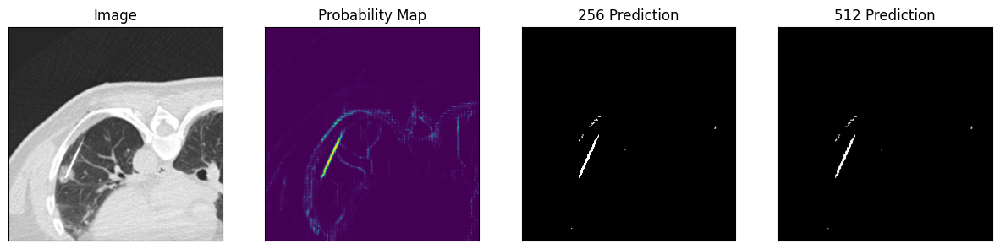

In [ ]:

# Define the size of your array
array_size = 256

# Define the size of your grid
grid_size = 10

# Generate the grid points
x = np.linspace(0, array_size-1, grid_size)
y = np.linspace(0, array_size-1, grid_size)

# Generate a grid of coordinates
xv, yv = np.meshgrid(x, y)

# Convert the numpy arrays to lists
xv_list = xv.tolist()
yv_list = yv.tolist()
# Combine the x and y coordinates into a list of list of lists
input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]

#We need to reshape our nxn grid to the expected shape of the input_points tensor
# (batch_size, point_batch_size, num_points_per_image, 2),
# where the last dimension of 2 represents the x and y coordinates of each point.
#batch_size: The number of images you're processing at once.
#point_batch_size: The number of point sets you have for each image.
#num_points_per_image: The number of points in each set.
input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)



# # Select a random patch for segmentation

# # Compute the total number of 256x256 arrays
# #num_arrays = patches.shape[0] * patches.shape[1]
# # Select a random index
# #index = np.random.choice(num_arrays)
# # Compute the indices in the original array
# #i = index // patches.shape[1]
# #j = index % patches.shape[1]

# #Or pick a specific patch for study.
# i, j = 1, 2

# # Selectelected patch for segmentation
# random_array = patches[i, j]


# single_patch = Image.fromarray(random_array)
# # prepare image for the model

# #First try without providing any prompt (no bounding box or input_points)
# #inputs = processor(single_patch, return_tensors="pt")
# #Now try with bounding boxes. Remember to uncomment.


image = image_data[4]['image']


image = image.convert("RGB")
m, s = np.mean(image, axis=(0, 1)), np.std(image, axis=(0, 1))
image = image.resize((256, 256))
image_np = np.array(image)
image_tensor = torch.from_numpy(image_np).float()
# image_tensor = image_tensor.permute(1,2,0)
print(image_tensor.shape)

# norm_image = transforms.Normalize(mean=m, std=s)
#We will just use a single image instead of patchifying
inputs = processor(image_tensor, input_points=input_points, return_tensors="pt")

# Move the input tensor to the GPU if it's not already there
inputs = {k: v.to(device) for k, v in inputs.items()}
model.eval()


# forward pass
with torch.no_grad():
    outputs = model(**inputs, multimask_output=False)

# apply sigmoid
single_patch_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
single_patch_prob = single_patch_prob.cpu().numpy().squeeze()
single_patch_prediction = (single_patch_prob > 0.5).astype(np.uint8)

#trying to resize from prediction
######
######
mask_image = Image.fromarray(single_patch_prediction)
mask_image = mask_image.resize((512,512))
######
######


# fig, axes = plt.subplots(1, 3, figsize=(15, 5))
fig, axes = plt.subplots(1, 4, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(single_patch_prob)  # Assuming the second image is grayscale
axes[1].set_title("Probability Map")

# # Plot the second image on the right
axes[2].imshow(single_patch_prediction, cmap='gray')  # Assuming the second image is grayscale
axes[2].set_title("256 Prediction")

# Plot the second image on the right
axes[3].imshow(mask_image, cmap='gray')  # Assuming the second image is grayscale
axes[3].set_title("512 Prediction")


# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

  0%|                                                   | 0/127 [00:00<?, ?it/s]

255
IMAGE IS BINARY


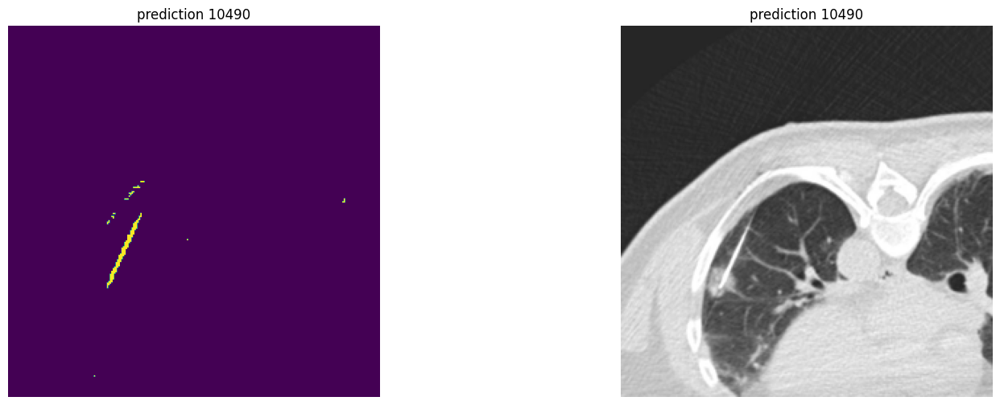

  1%|▎                                          | 1/127 [00:06<14:15,  6.79s/it]

255
IMAGE IS BINARY


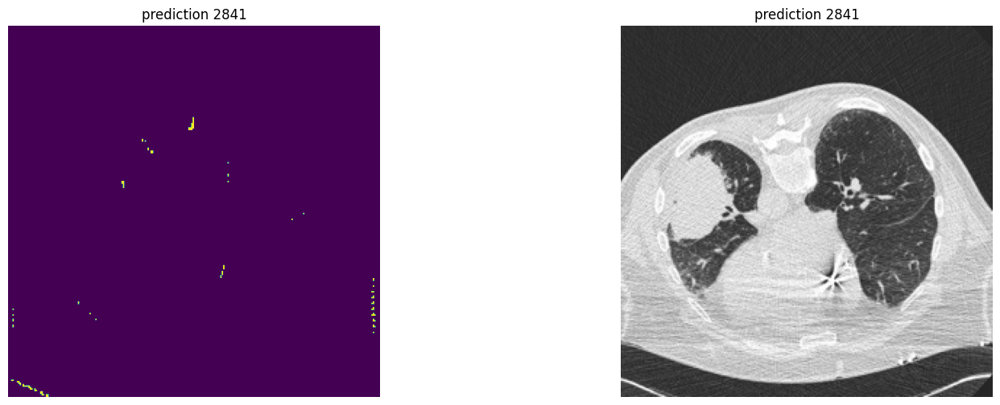

  2%|▋                                          | 2/127 [00:13<14:08,  6.79s/it]

255
IMAGE IS BINARY


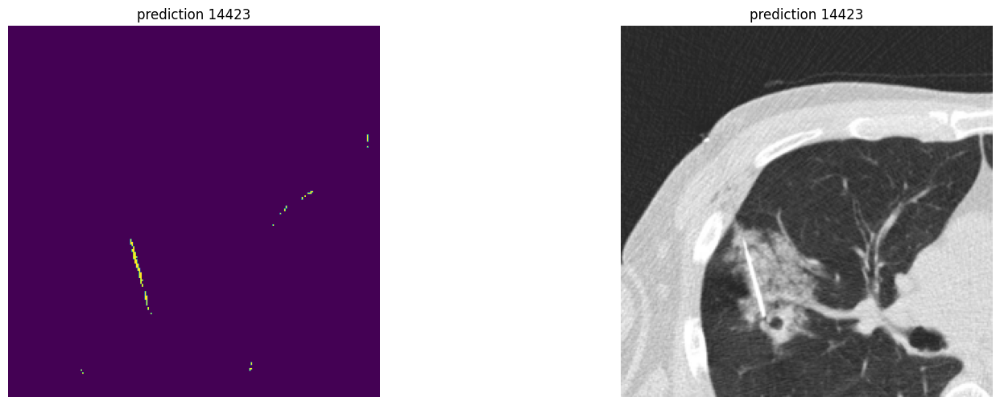

  2%|█                                          | 3/127 [00:20<13:52,  6.72s/it]

255
IMAGE IS BINARY


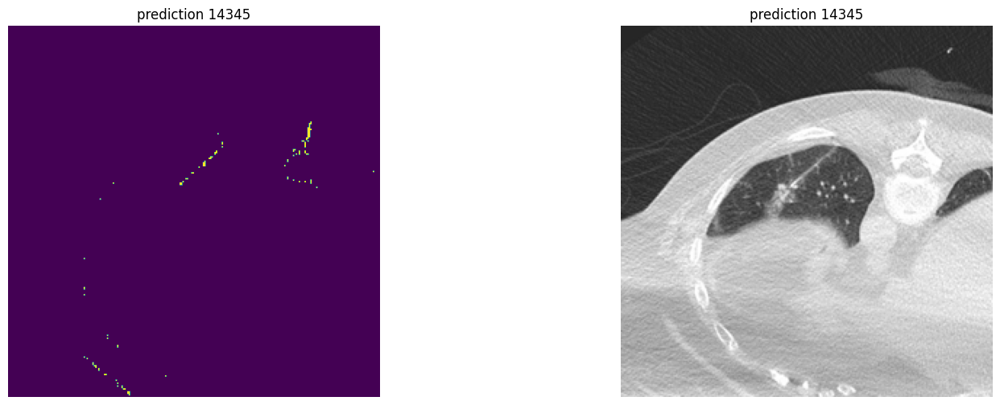

  3%|█▎                                         | 4/127 [00:26<13:46,  6.72s/it]

255
IMAGE IS BINARY


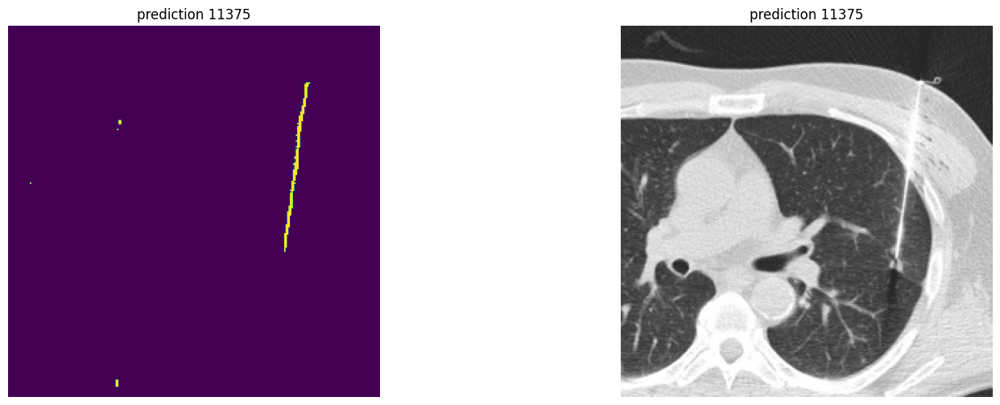

  4%|█▋                                         | 5/127 [00:33<13:43,  6.75s/it]

255
IMAGE IS BINARY


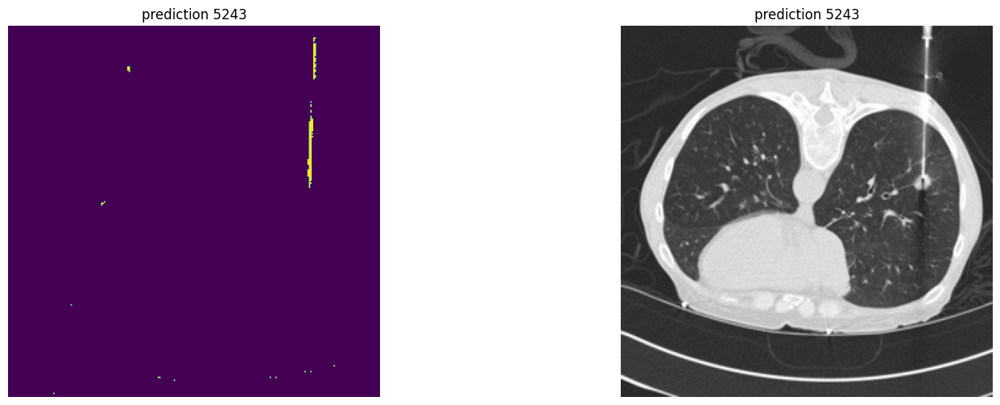

  5%|██                                         | 6/127 [00:40<13:37,  6.76s/it]

255
IMAGE IS BINARY


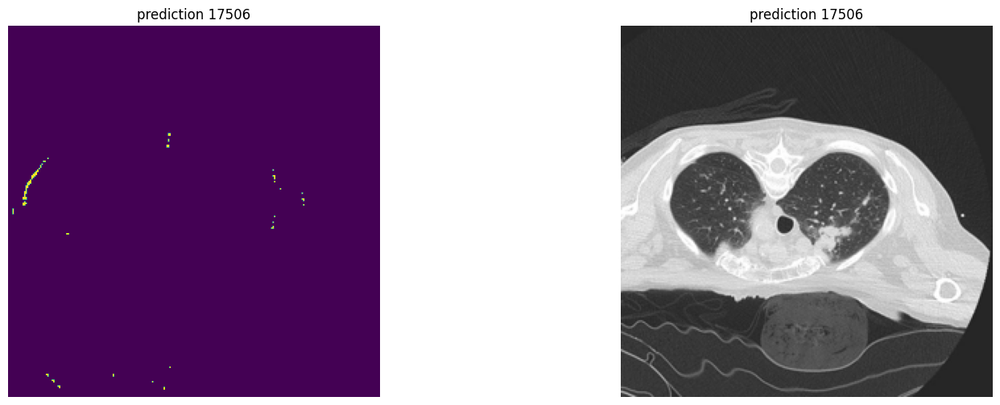

  6%|██▎                                        | 7/127 [00:47<13:26,  6.72s/it]

255
IMAGE IS BINARY


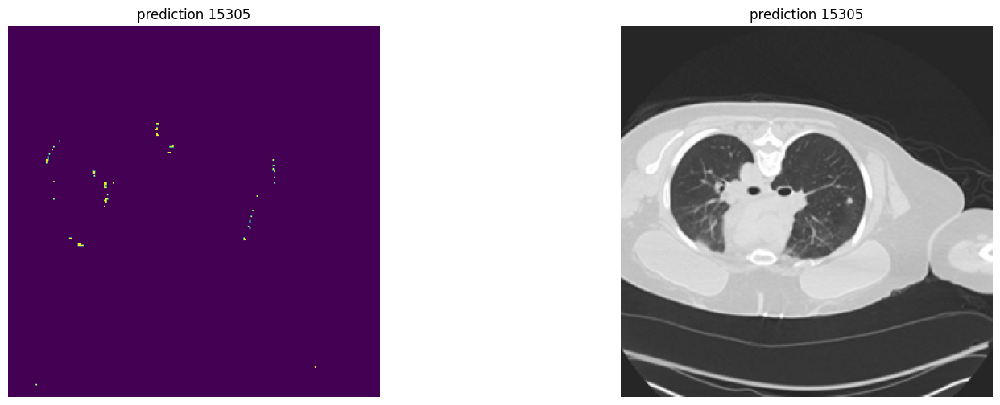

  6%|██▋                                        | 8/127 [00:53<13:20,  6.73s/it]

255
IMAGE IS BINARY


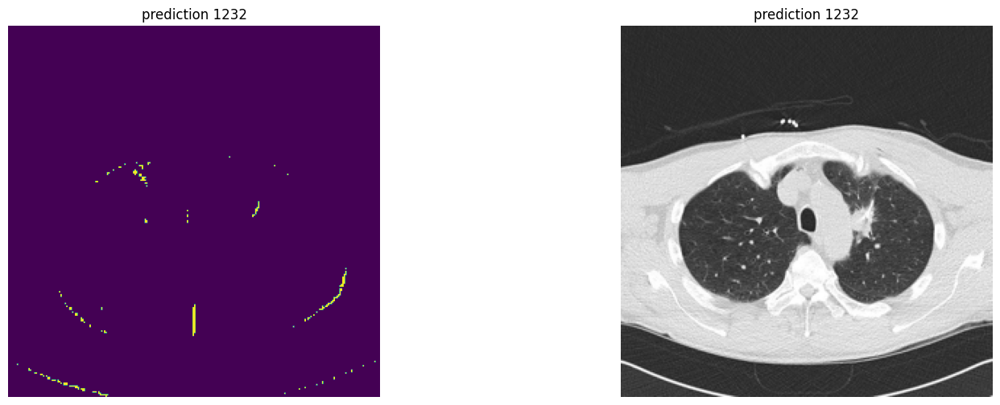

  7%|███                                        | 9/127 [01:00<13:18,  6.77s/it]

255
IMAGE IS BINARY


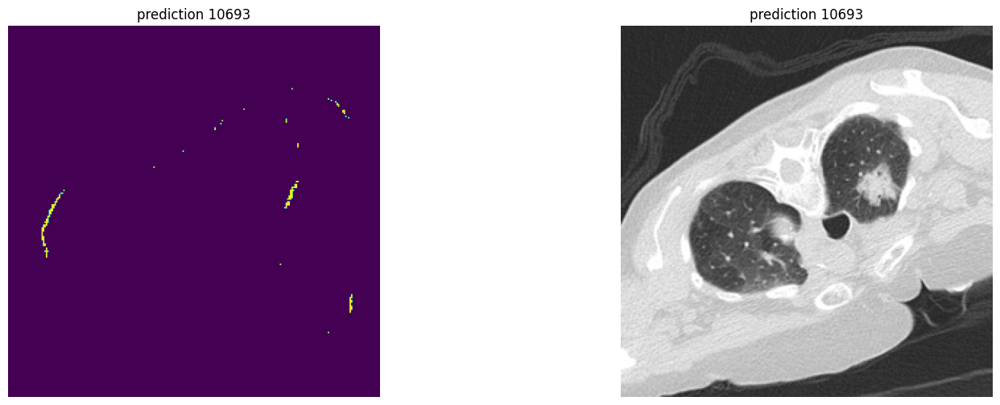

  8%|███▎                                      | 10/127 [01:07<13:15,  6.80s/it]

255
IMAGE IS BINARY


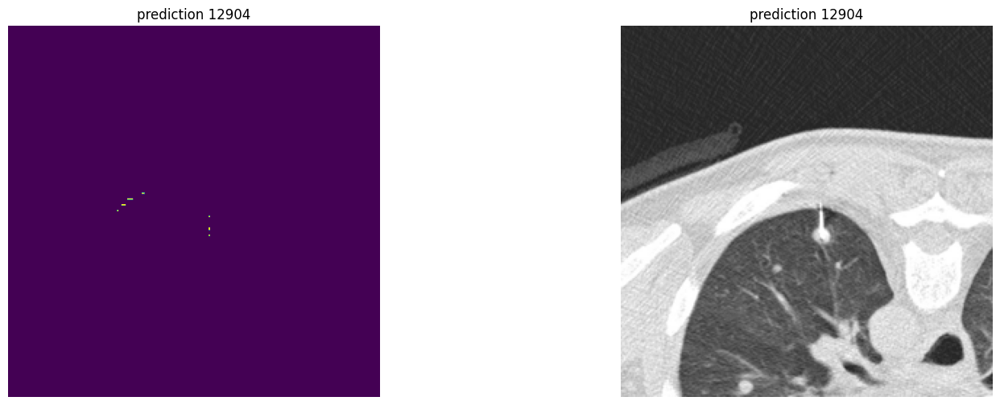

  9%|███▋                                      | 11/127 [01:14<13:03,  6.75s/it]

255
IMAGE IS BINARY


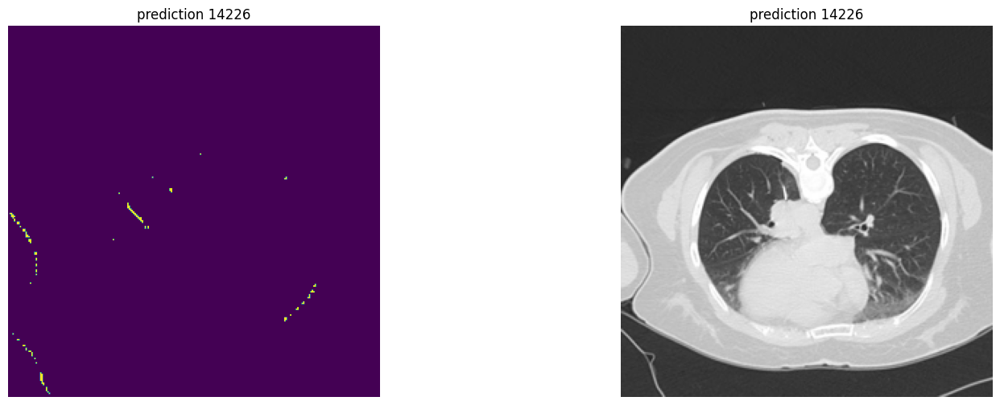

  9%|███▉                                      | 12/127 [01:21<12:56,  6.75s/it]

255
IMAGE IS BINARY


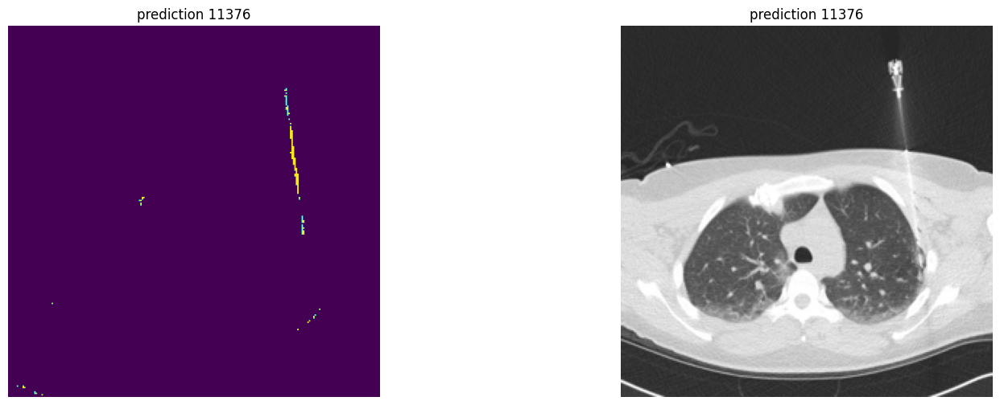

 10%|████▎                                     | 13/127 [01:27<12:56,  6.81s/it]

255
IMAGE IS BINARY


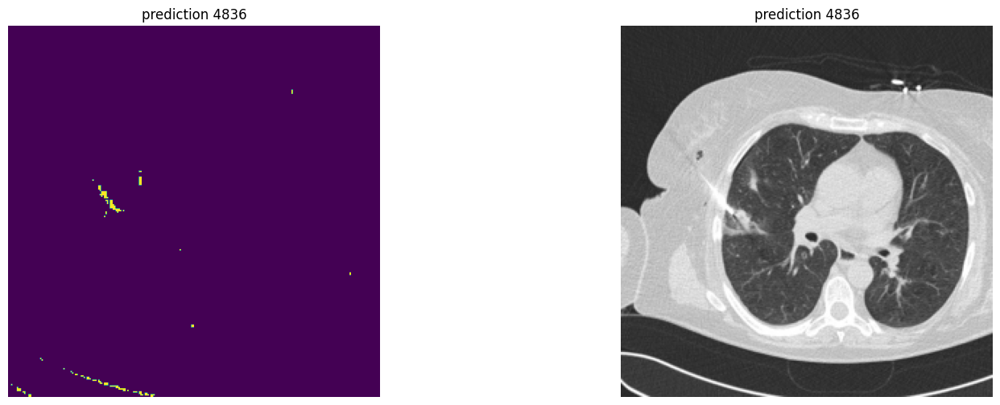

 11%|████▋                                     | 14/127 [01:35<13:17,  7.06s/it]

255
IMAGE IS BINARY


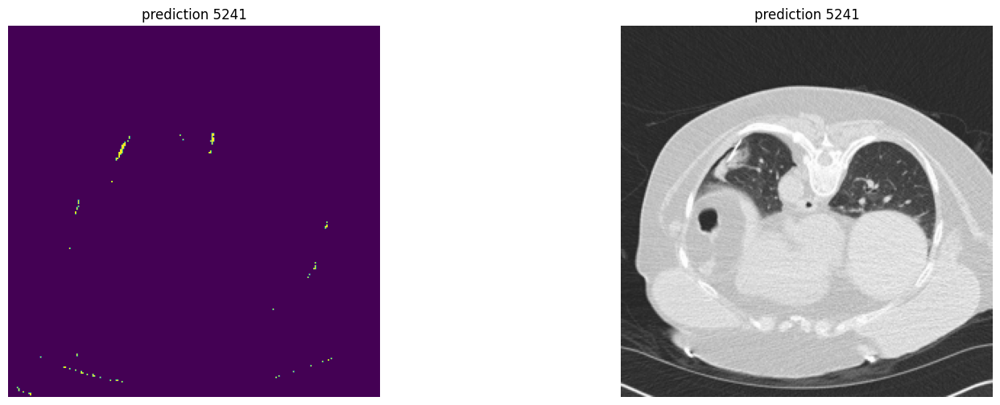

 12%|████▉                                     | 15/127 [01:42<13:06,  7.02s/it]

255
IMAGE IS BINARY


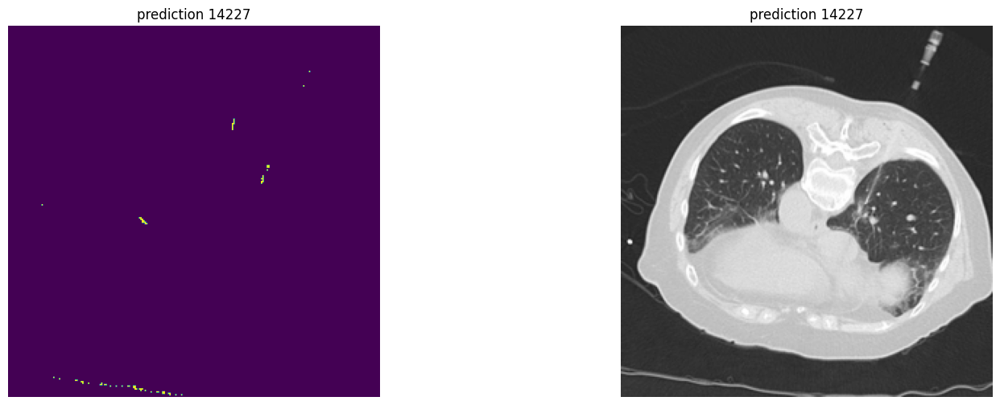

 13%|█████▎                                    | 16/127 [01:49<12:50,  6.94s/it]

255
IMAGE IS BINARY


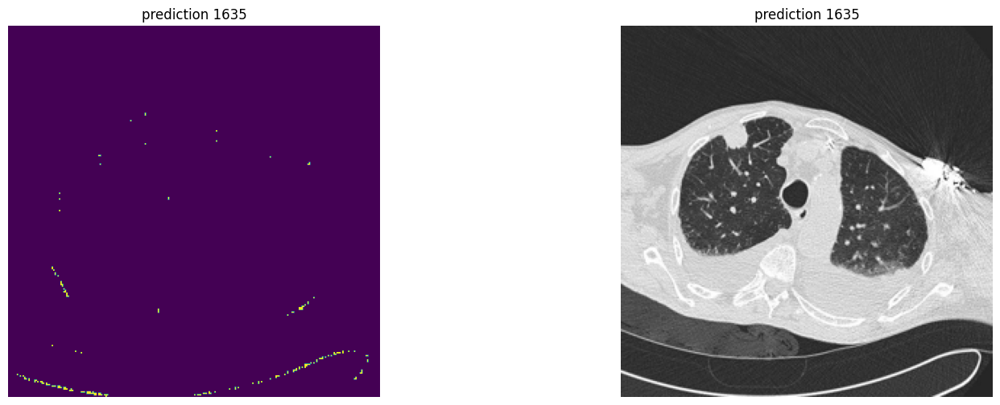

 13%|█████▌                                    | 17/127 [01:56<12:52,  7.02s/it]

255
IMAGE IS BINARY


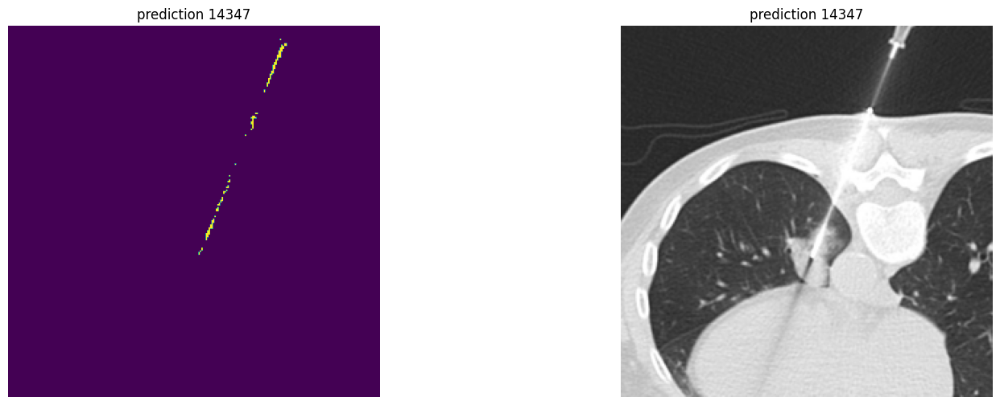

 14%|█████▉                                    | 18/127 [02:03<12:41,  6.98s/it]

255
IMAGE IS BINARY


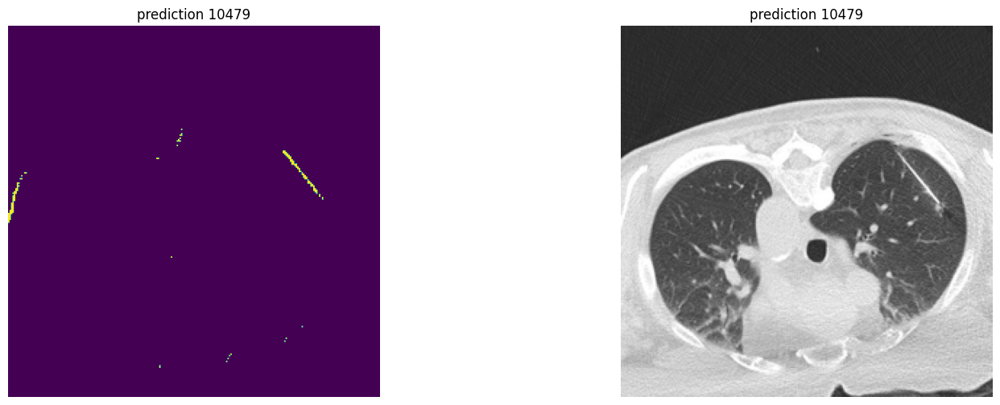

 15%|██████▎                                   | 19/127 [02:10<12:46,  7.09s/it]

255
IMAGE IS BINARY


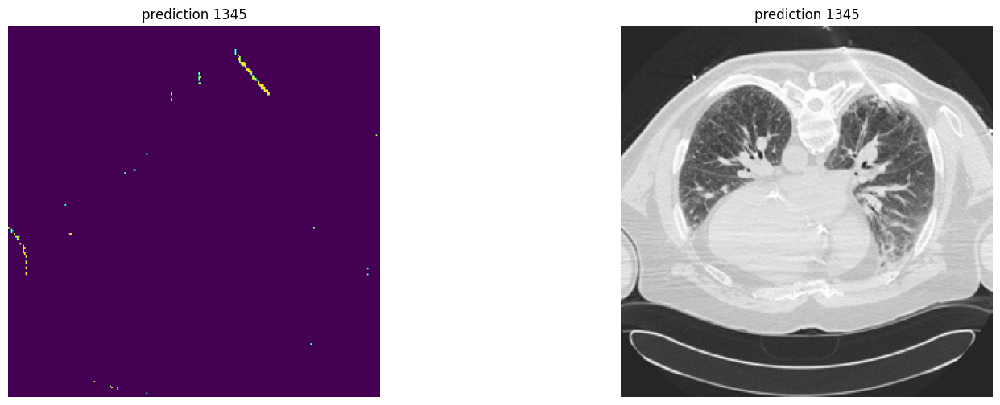

 16%|██████▌                                   | 20/127 [02:18<12:50,  7.20s/it]

255
IMAGE IS BINARY


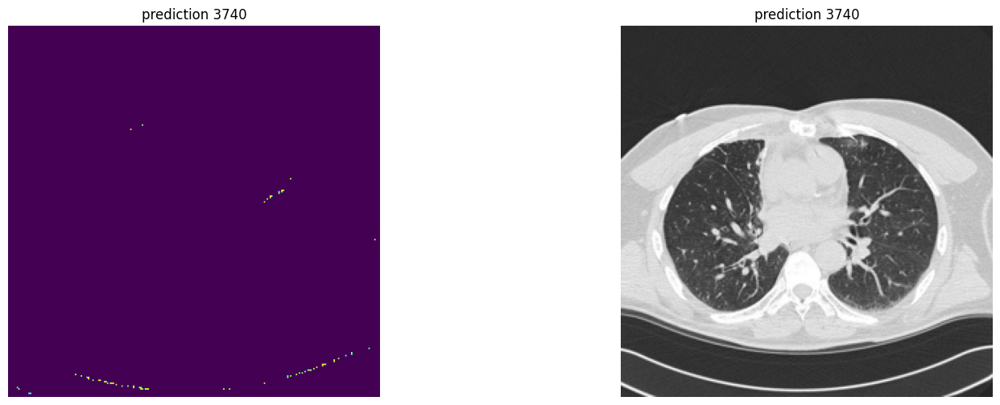

 17%|██████▉                                   | 21/127 [02:25<12:54,  7.31s/it]

255
IMAGE IS BINARY


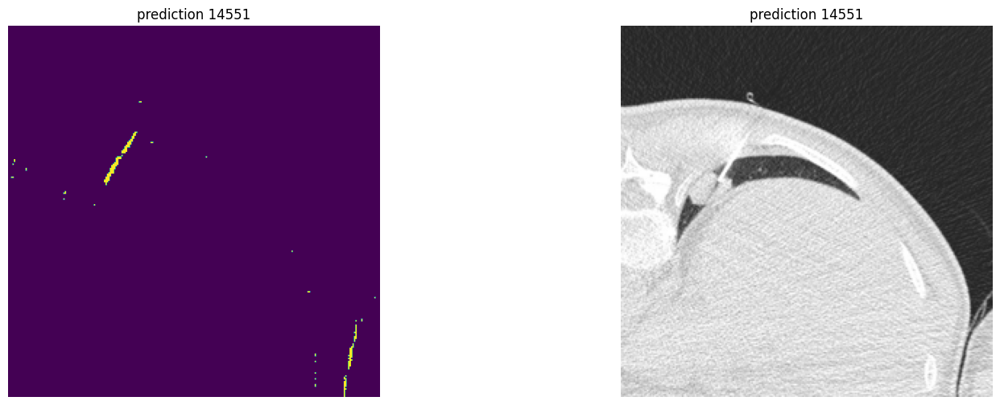

 17%|███████▎                                  | 22/127 [02:32<12:45,  7.29s/it]

255
IMAGE IS BINARY


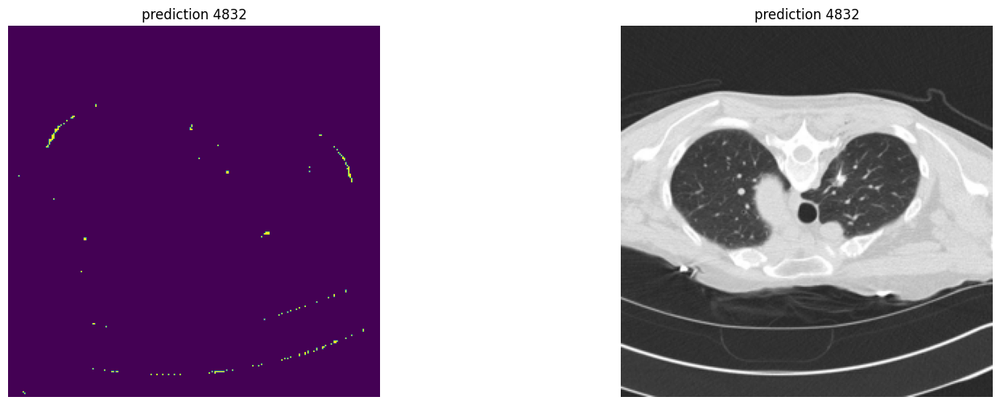

 18%|███████▌                                  | 23/127 [02:40<12:39,  7.30s/it]

255
IMAGE IS BINARY


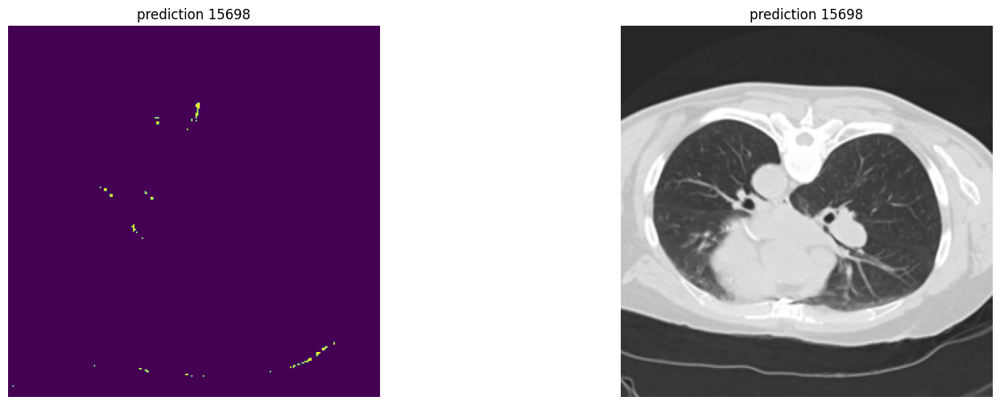

 19%|███████▉                                  | 24/127 [02:47<12:28,  7.27s/it]

255
IMAGE IS BINARY


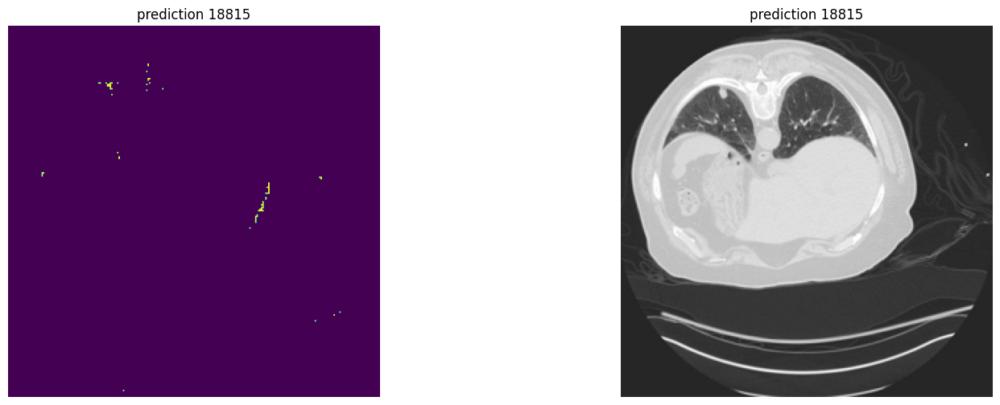

 20%|████████▎                                 | 25/127 [02:54<12:24,  7.30s/it]

255
IMAGE IS BINARY


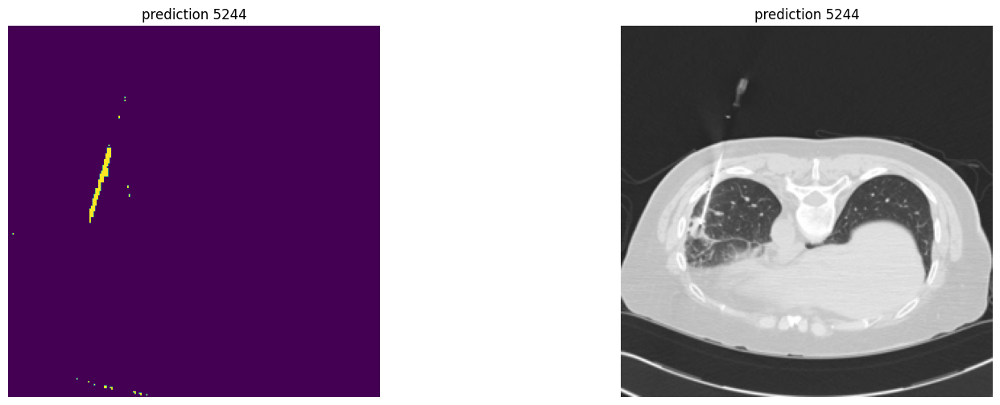

 20%|████████▌                                 | 26/127 [03:02<12:16,  7.29s/it]

255
IMAGE IS BINARY


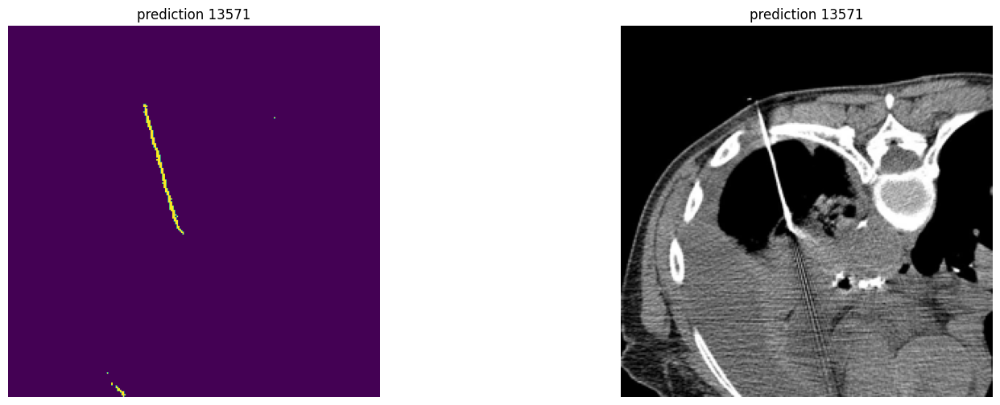

 21%|████████▉                                 | 27/127 [03:09<12:09,  7.29s/it]

255
IMAGE IS BINARY


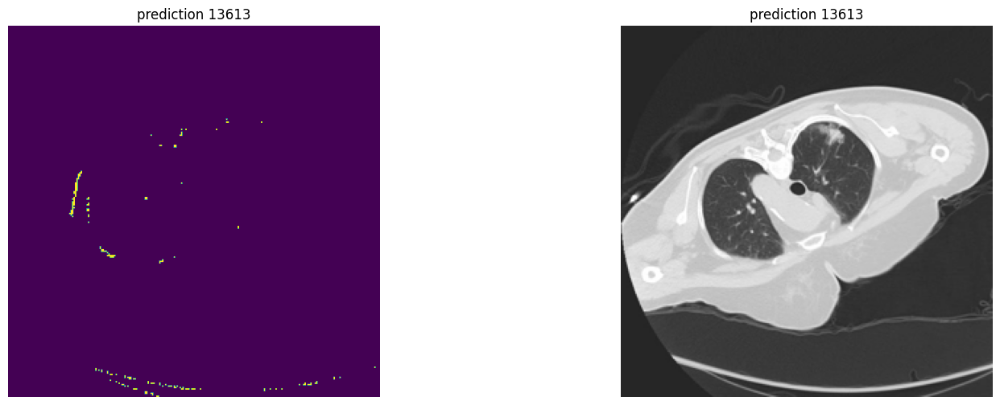

 22%|█████████▎                                | 28/127 [03:16<12:03,  7.31s/it]

255
IMAGE IS BINARY


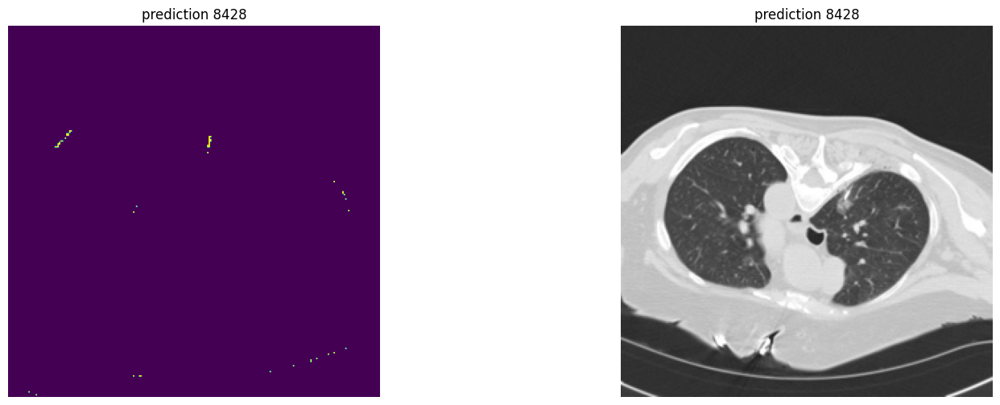

 23%|█████████▌                                | 29/127 [03:24<11:54,  7.29s/it]

255
IMAGE IS BINARY


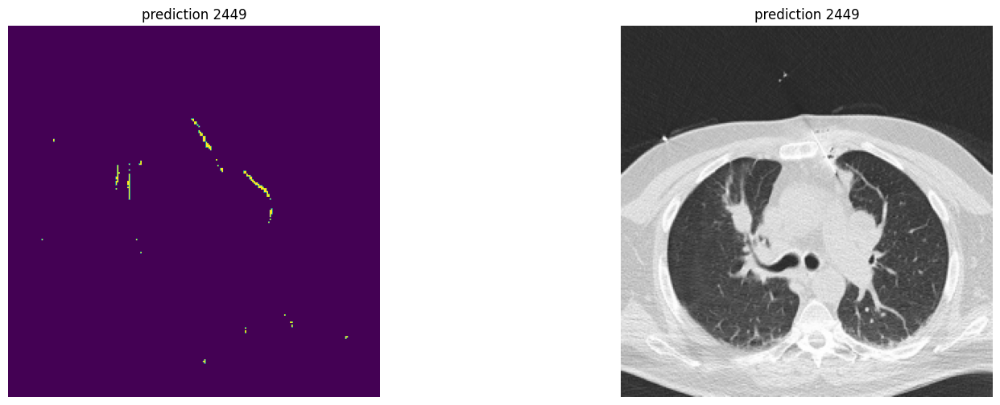

 24%|█████████▉                                | 30/127 [03:31<11:52,  7.35s/it]

255
IMAGE IS BINARY


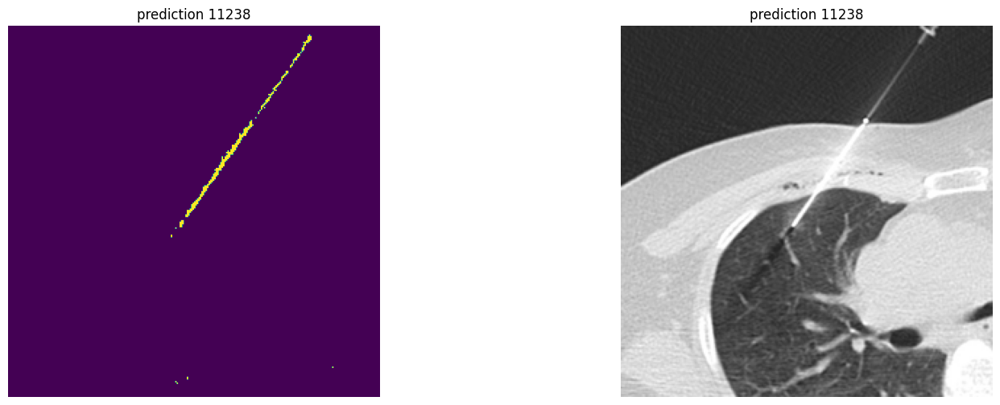

 24%|██████████▎                               | 31/127 [03:38<11:41,  7.30s/it]

255
IMAGE IS BINARY


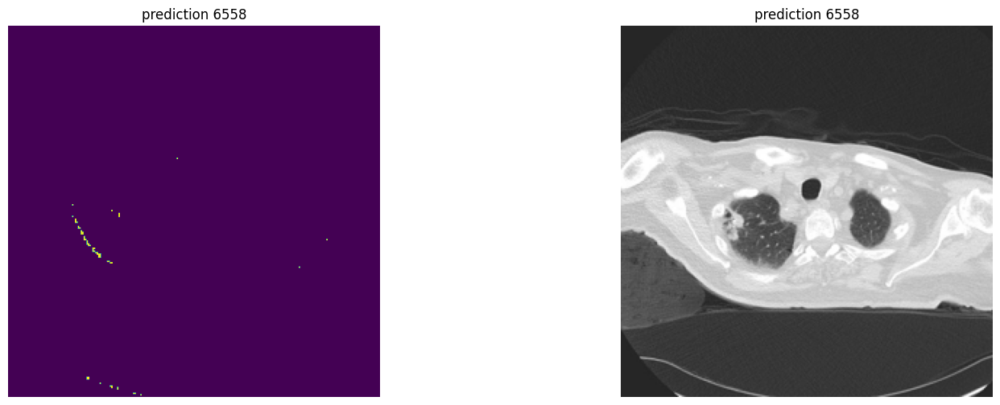

 25%|██████████▌                               | 32/127 [03:46<11:36,  7.33s/it]

255
IMAGE IS BINARY


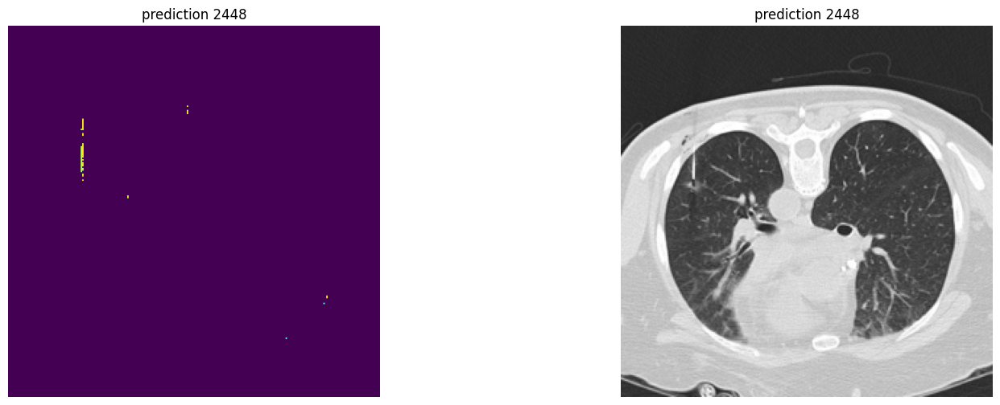

 26%|██████████▉                               | 33/127 [03:53<11:27,  7.31s/it]

255
IMAGE IS BINARY


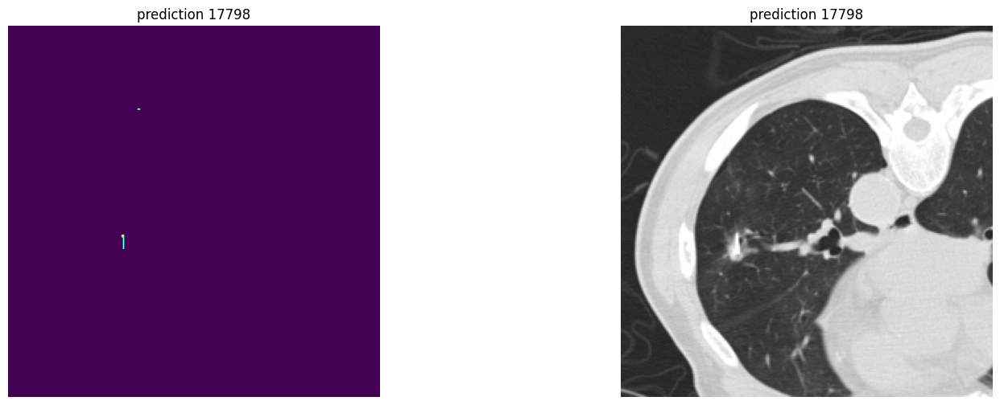

 27%|███████████▏                              | 34/127 [04:00<11:24,  7.36s/it]

255
IMAGE IS BINARY


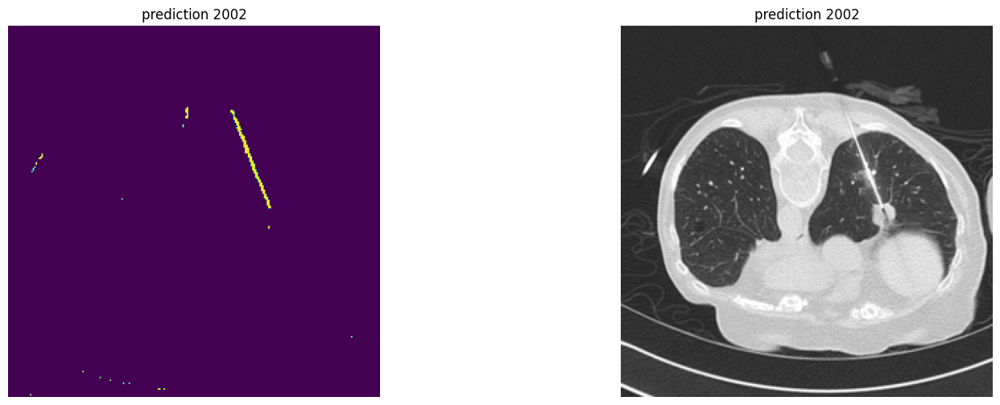

 28%|███████████▌                              | 35/127 [04:08<11:17,  7.36s/it]

255
IMAGE IS BINARY


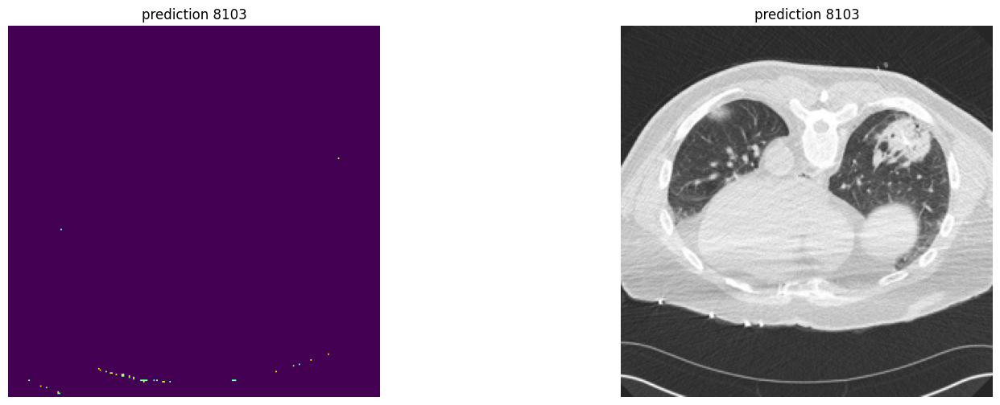

 28%|███████████▉                              | 36/127 [04:15<11:07,  7.34s/it]

255
IMAGE IS BINARY


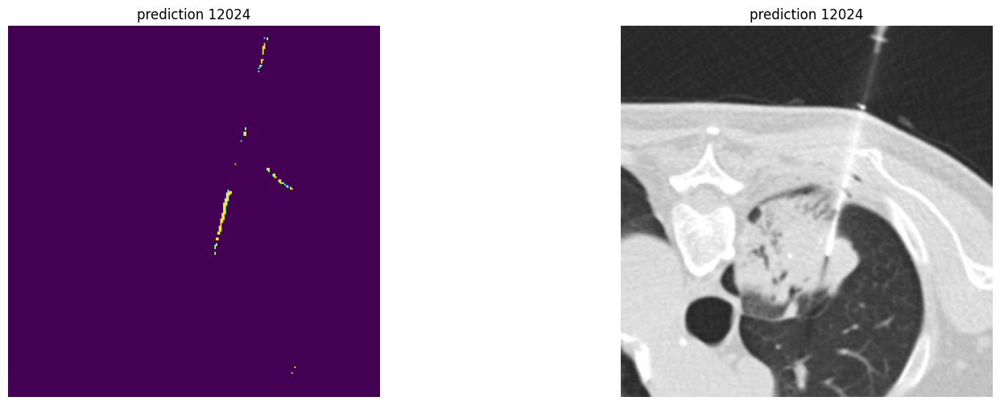

 29%|████████████▏                             | 37/127 [04:22<10:58,  7.32s/it]

255
IMAGE IS BINARY


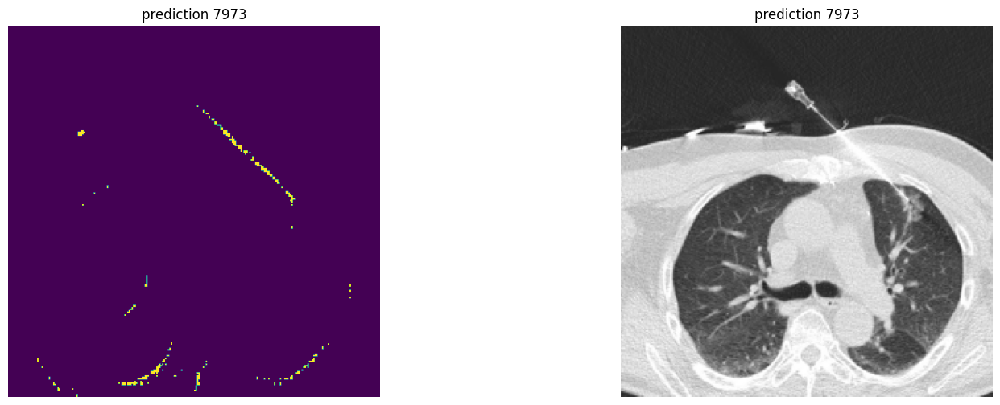

 30%|████████████▌                             | 38/127 [04:30<10:58,  7.40s/it]

255
IMAGE IS BINARY


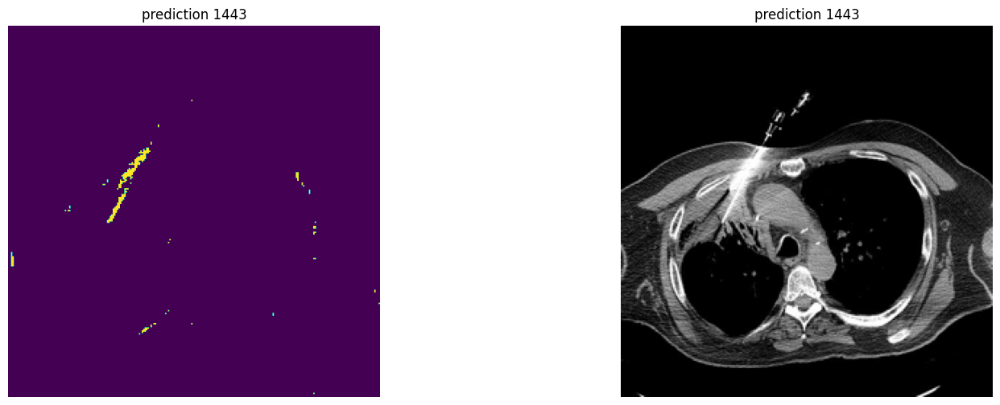

 31%|████████████▉                             | 39/127 [04:37<10:45,  7.34s/it]

255
IMAGE IS BINARY


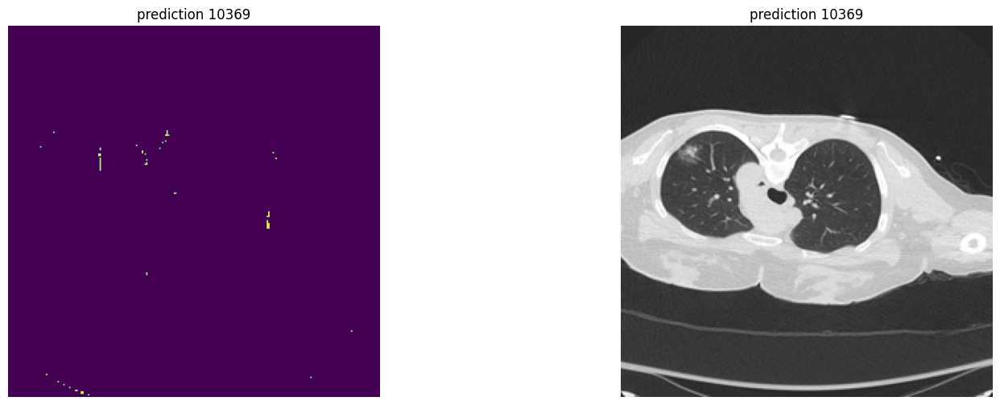

 31%|█████████████▏                            | 40/127 [04:44<10:37,  7.33s/it]

255
IMAGE IS BINARY


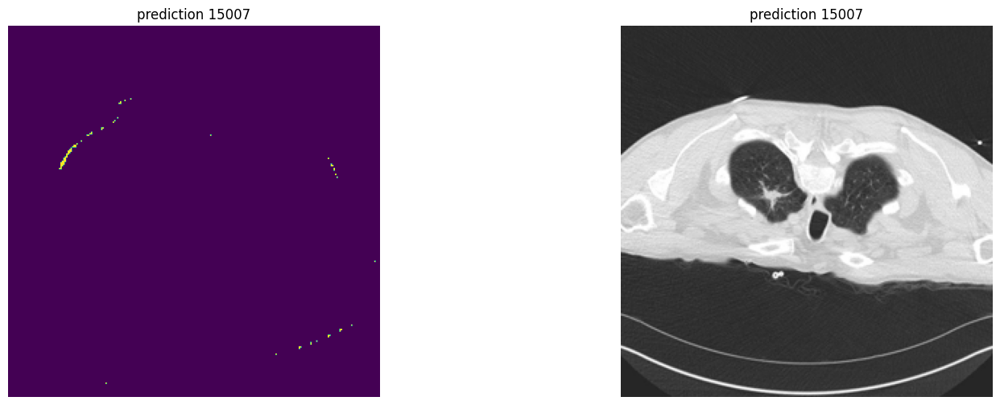

 32%|█████████████▌                            | 41/127 [04:52<10:30,  7.33s/it]

255
IMAGE IS BINARY


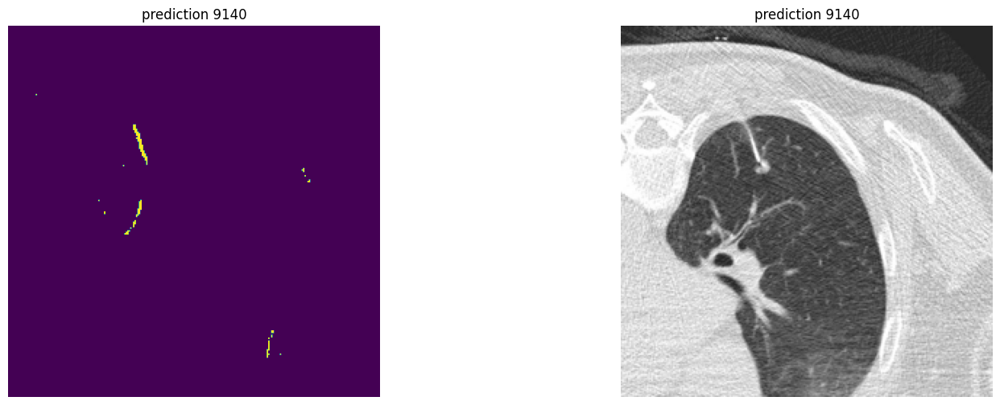

 33%|█████████████▉                            | 42/127 [04:59<10:26,  7.37s/it]

255
IMAGE IS BINARY


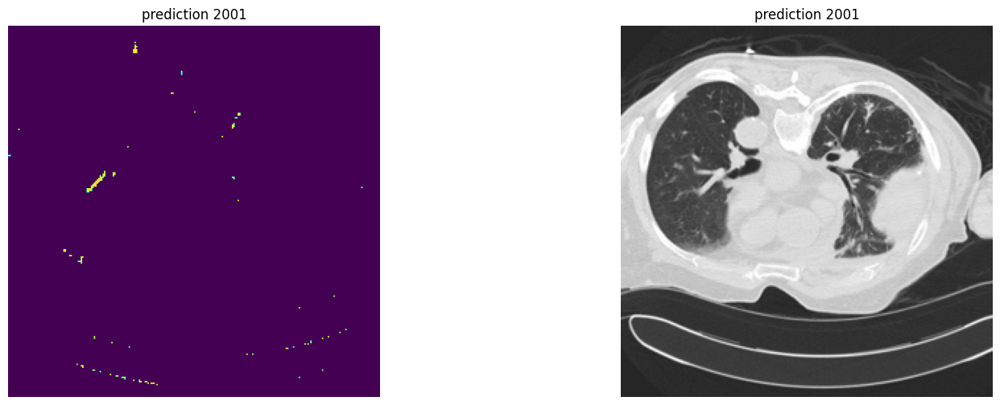

 34%|██████████████▏                           | 43/127 [05:07<10:23,  7.42s/it]

255
IMAGE IS BINARY


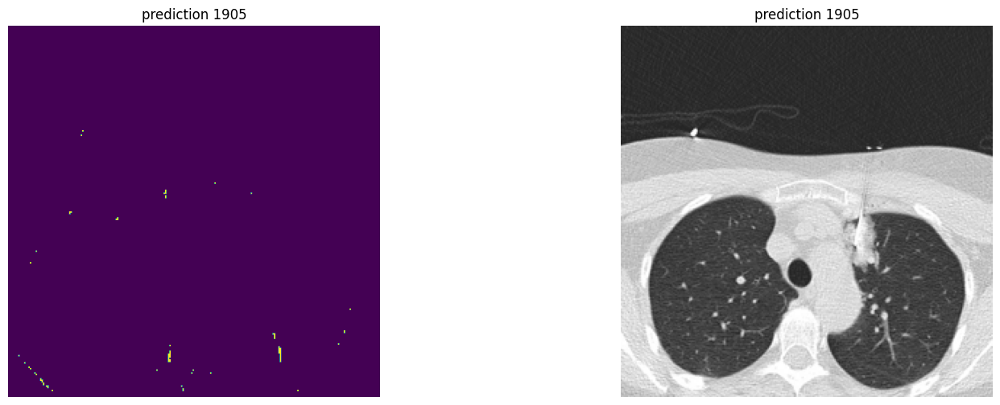

 35%|██████████████▌                           | 44/127 [05:14<10:15,  7.42s/it]

255
IMAGE IS BINARY


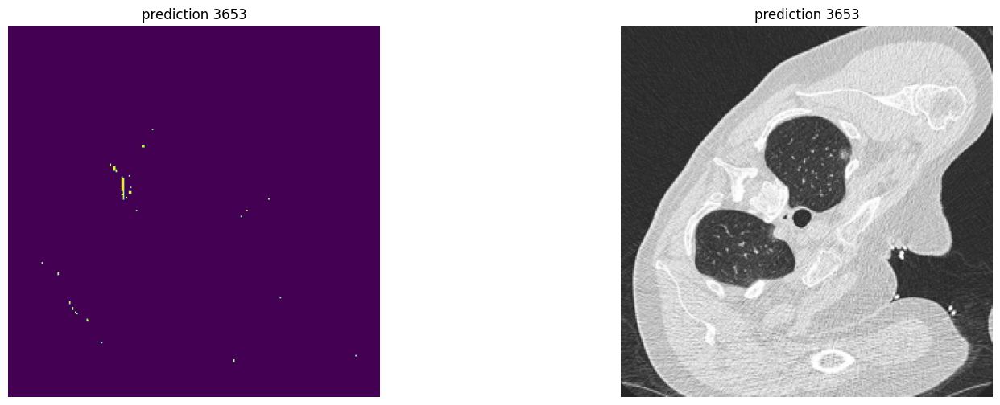

 35%|██████████████▉                           | 45/127 [05:22<10:10,  7.44s/it]

255
IMAGE IS BINARY


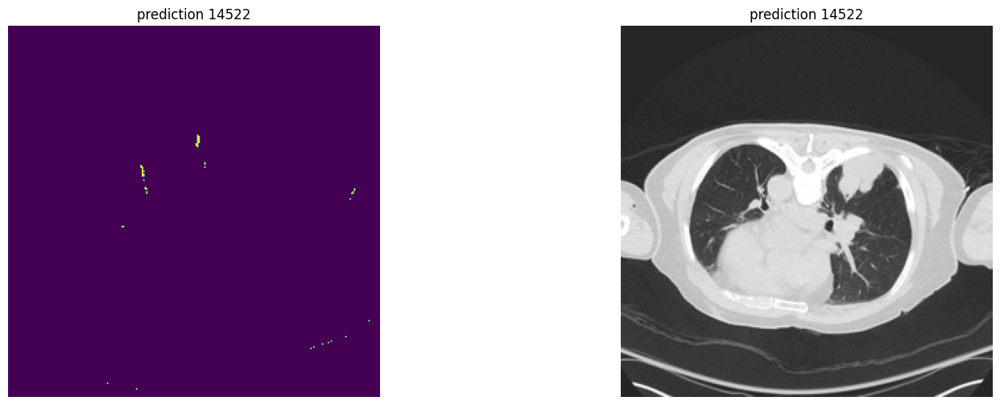

 36%|███████████████▏                          | 46/127 [05:29<10:02,  7.44s/it]

255
IMAGE IS BINARY


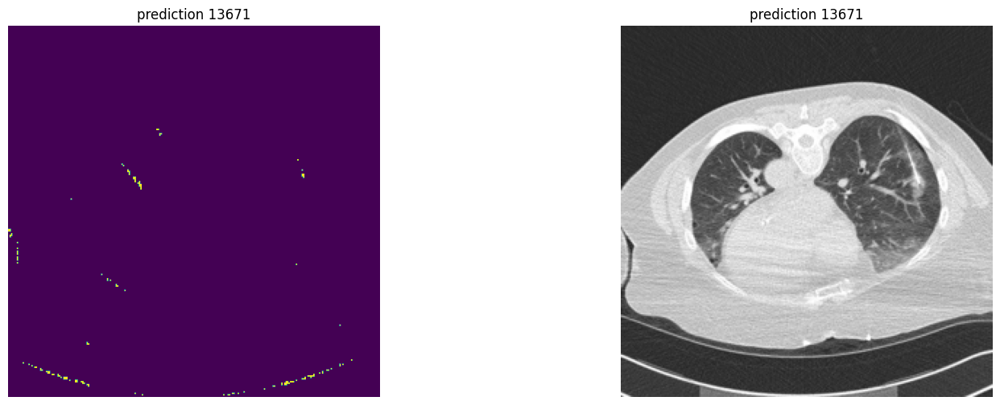

 37%|███████████████▌                          | 47/127 [05:36<09:43,  7.30s/it]

255
IMAGE IS BINARY


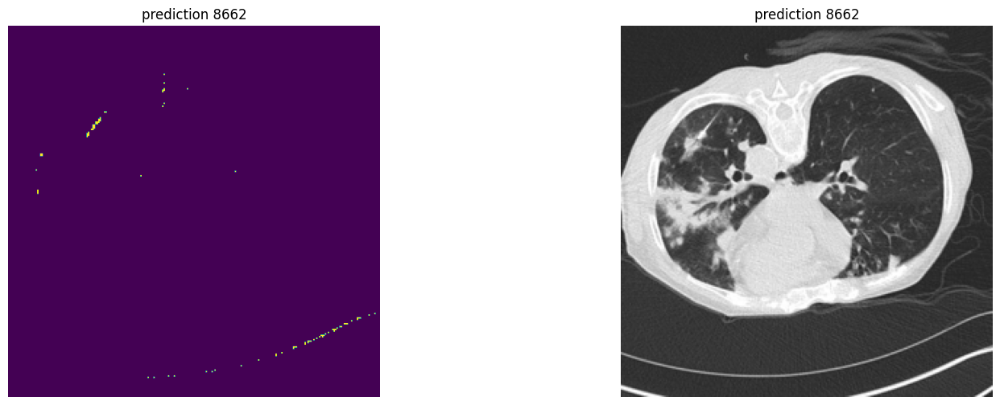

 38%|███████████████▊                          | 48/127 [05:43<09:28,  7.20s/it]

255
IMAGE IS BINARY


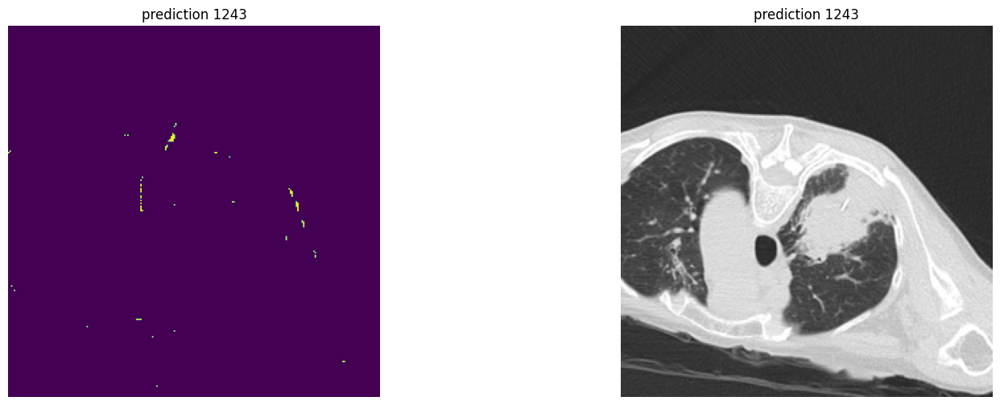

 39%|████████████████▏                         | 49/127 [05:50<09:15,  7.12s/it]

255
IMAGE IS BINARY


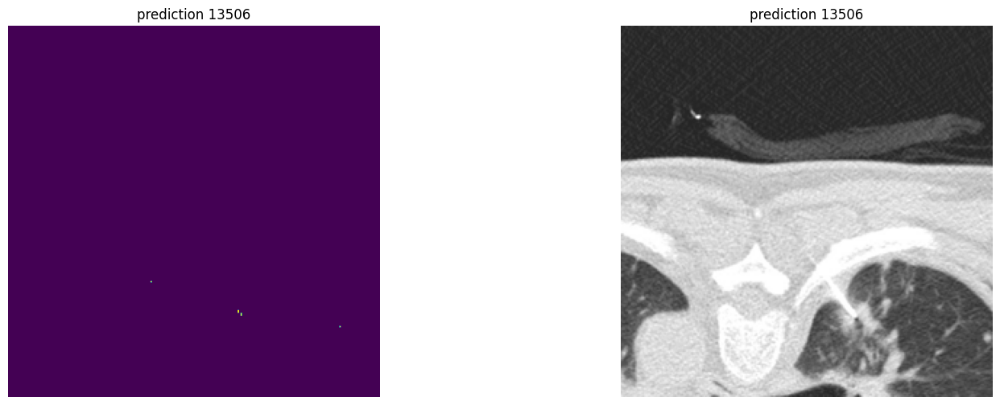

 39%|████████████████▌                         | 50/127 [05:57<09:04,  7.08s/it]

255
IMAGE IS BINARY


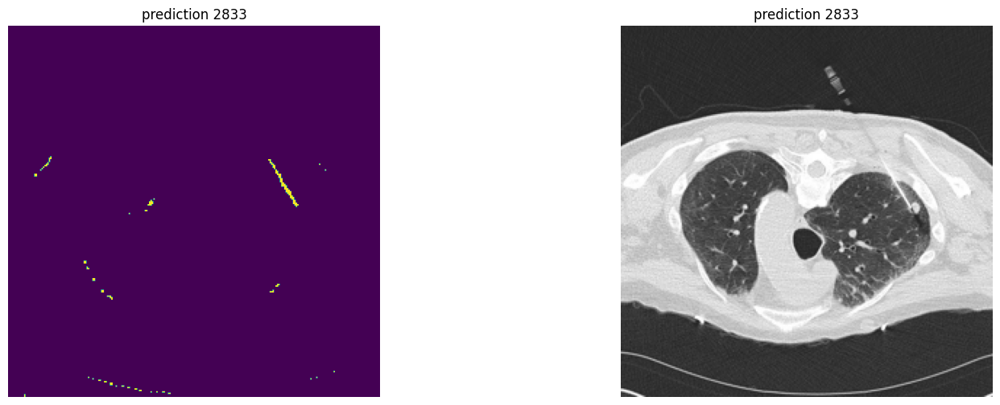

 40%|████████████████▊                         | 51/127 [06:04<08:52,  7.01s/it]

255
IMAGE IS BINARY


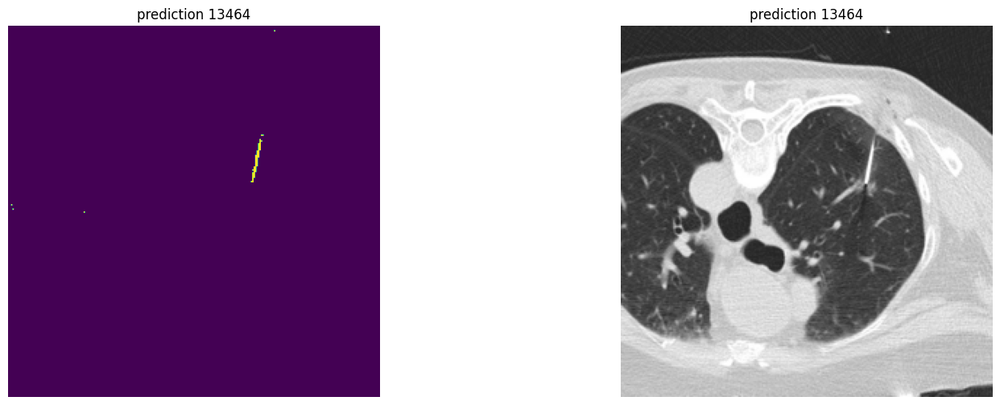

 41%|█████████████████▏                        | 52/127 [06:11<08:43,  6.98s/it]

255
IMAGE IS BINARY


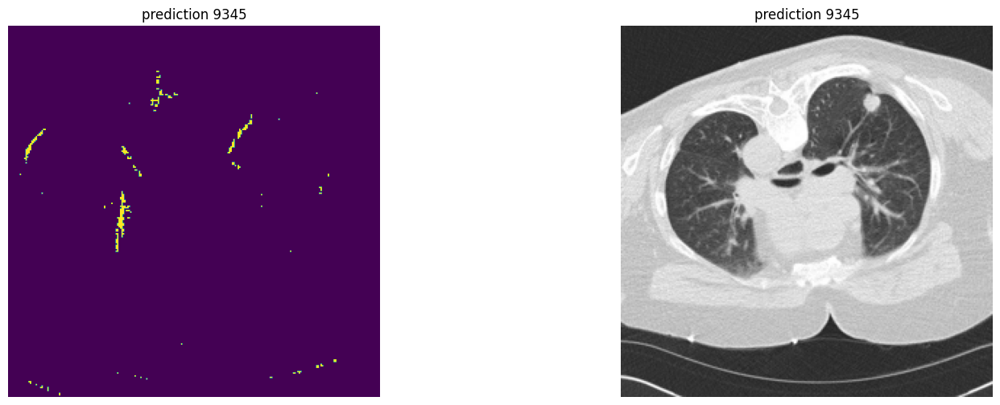

 42%|█████████████████▌                        | 53/127 [06:18<08:34,  6.95s/it]

255
IMAGE IS BINARY


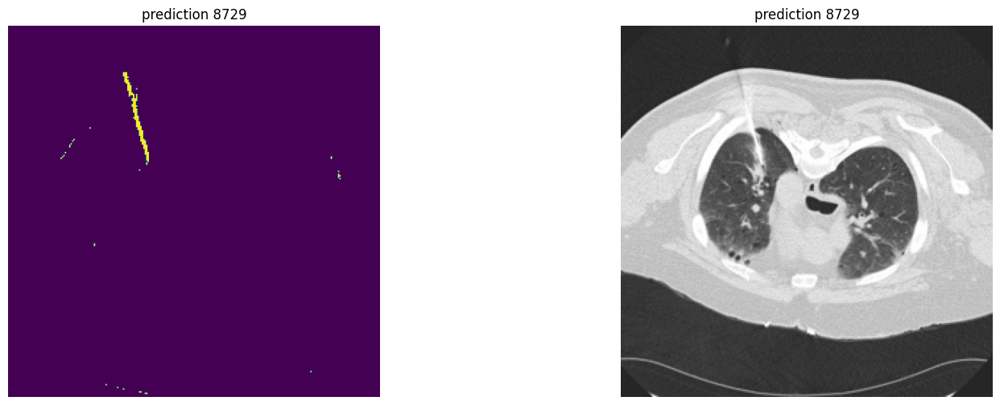

 43%|█████████████████▊                        | 54/127 [06:25<08:37,  7.09s/it]

255
IMAGE IS BINARY


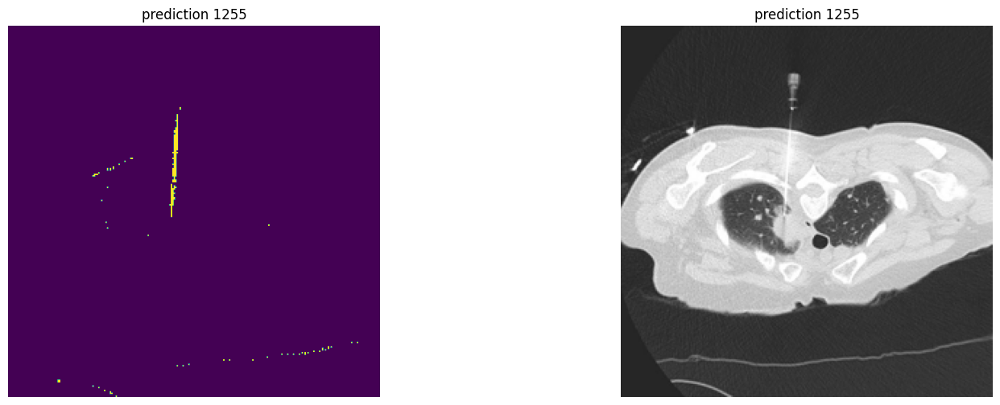

 43%|██████████████████▏                       | 55/127 [06:32<08:38,  7.20s/it]

255
IMAGE IS BINARY


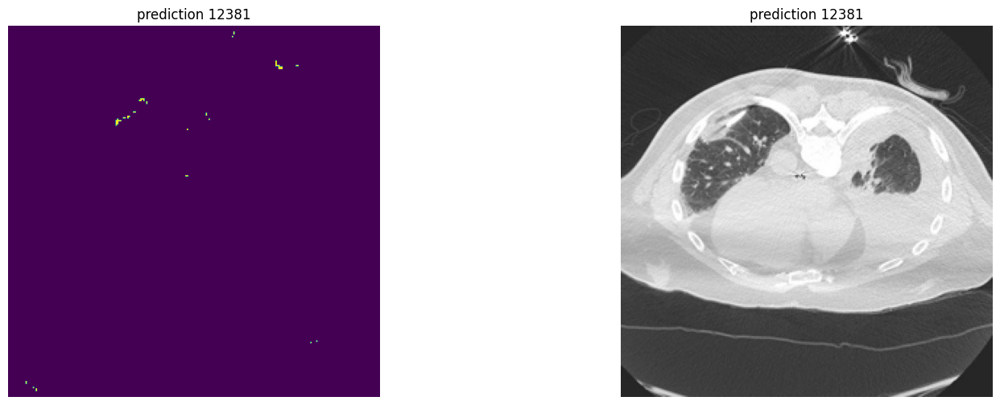

 44%|██████████████████▌                       | 56/127 [06:40<08:29,  7.18s/it]

255
IMAGE IS BINARY


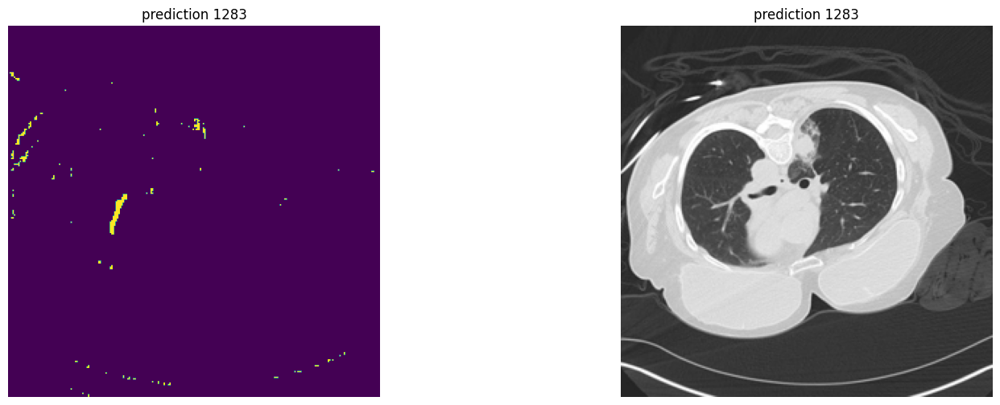

 45%|██████████████████▊                       | 57/127 [06:47<08:26,  7.24s/it]

255
IMAGE IS BINARY


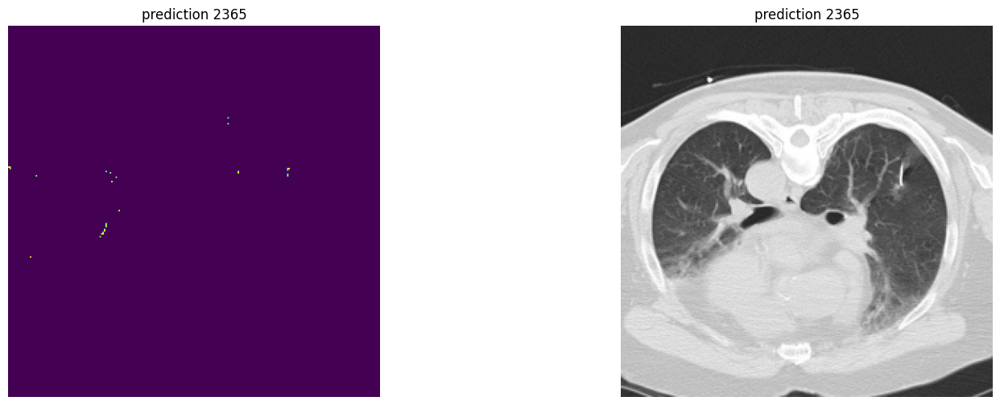

 46%|███████████████████▏                      | 58/127 [06:54<08:16,  7.19s/it]

255
IMAGE IS BINARY


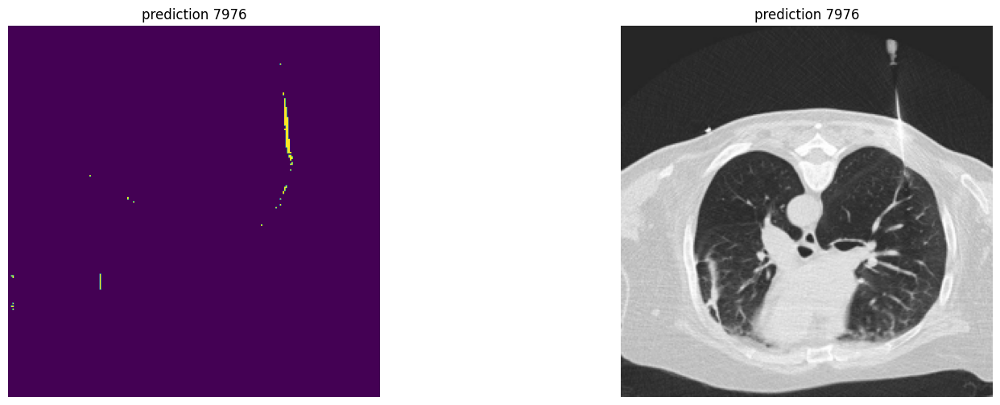

 46%|███████████████████▌                      | 59/127 [07:01<08:05,  7.15s/it]

255
IMAGE IS BINARY


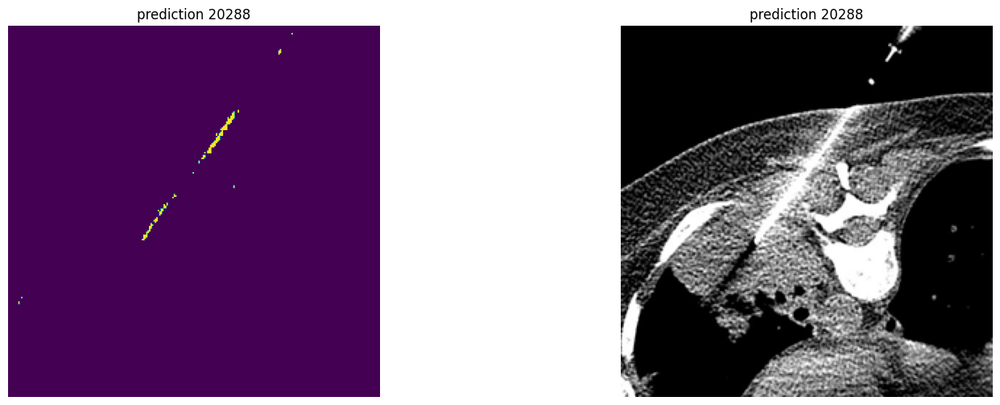

 47%|███████████████████▊                      | 60/127 [07:09<08:06,  7.26s/it]

255
IMAGE IS BINARY


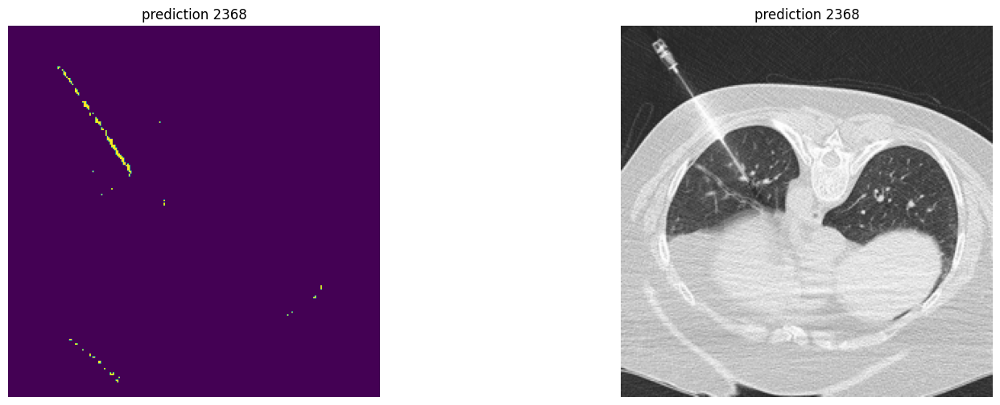

 48%|████████████████████▏                     | 61/127 [07:16<07:57,  7.24s/it]

255
IMAGE IS BINARY


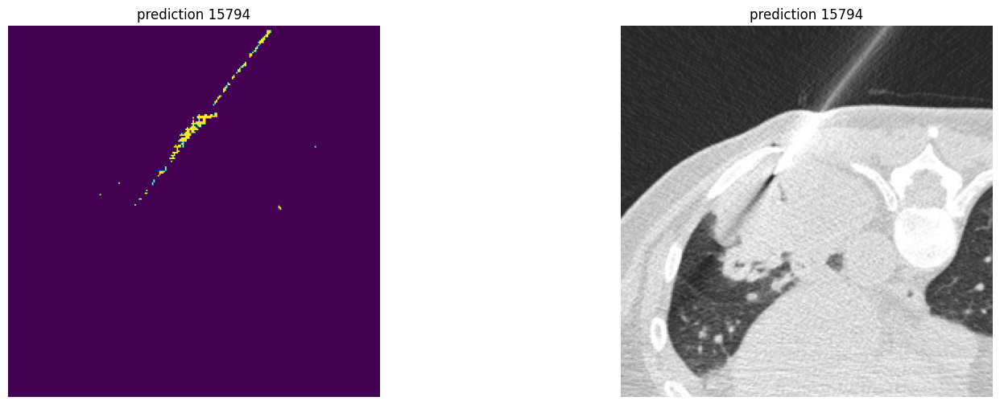

 49%|████████████████████▌                     | 62/127 [07:23<07:44,  7.14s/it]

255
IMAGE IS BINARY


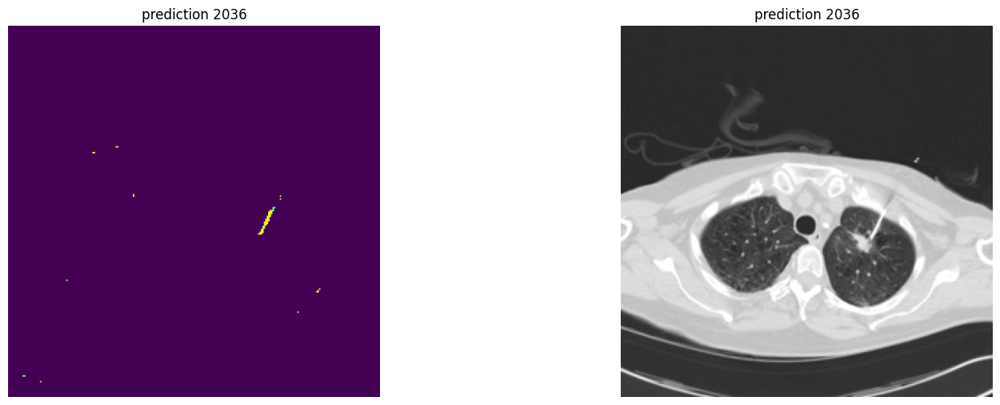

 50%|████████████████████▊                     | 63/127 [07:30<07:32,  7.07s/it]

255
IMAGE IS BINARY


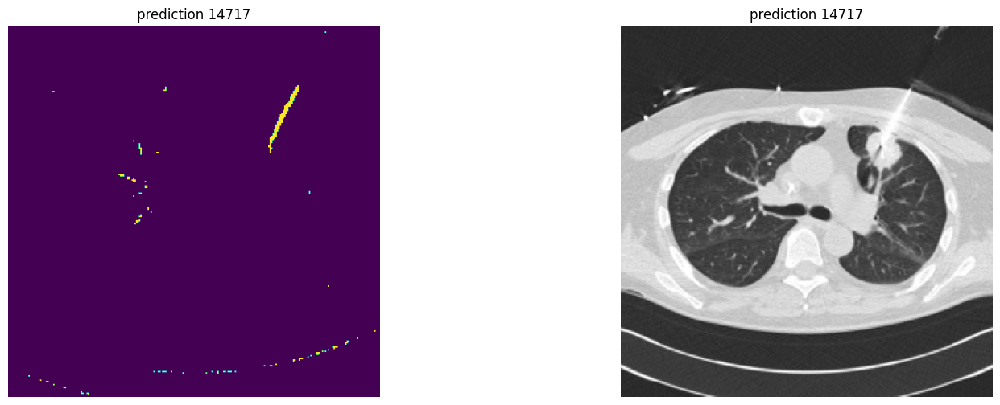

 50%|█████████████████████▏                    | 64/127 [07:37<07:24,  7.05s/it]

255
IMAGE IS BINARY


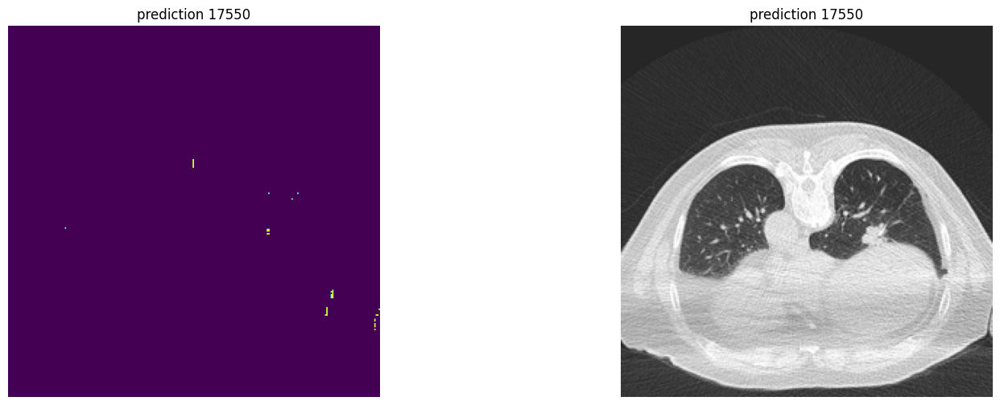

 51%|█████████████████████▍                    | 65/127 [07:44<07:15,  7.02s/it]

255
IMAGE IS BINARY


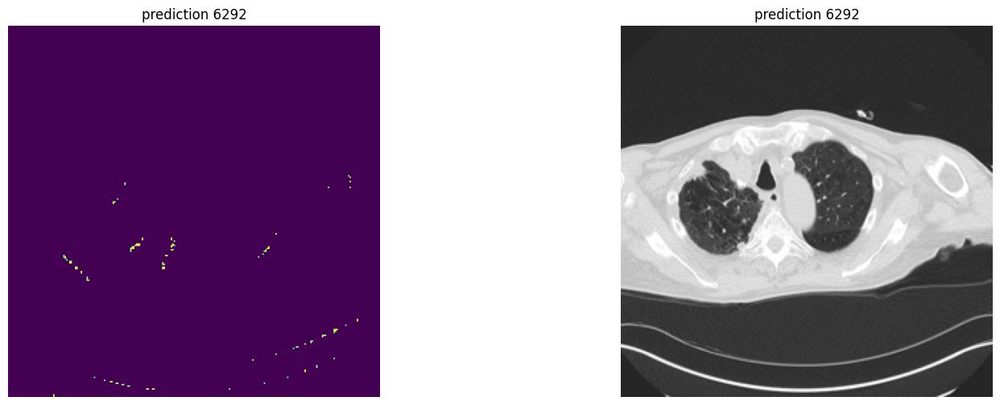

 52%|█████████████████████▊                    | 66/127 [07:51<07:08,  7.02s/it]

255
IMAGE IS BINARY


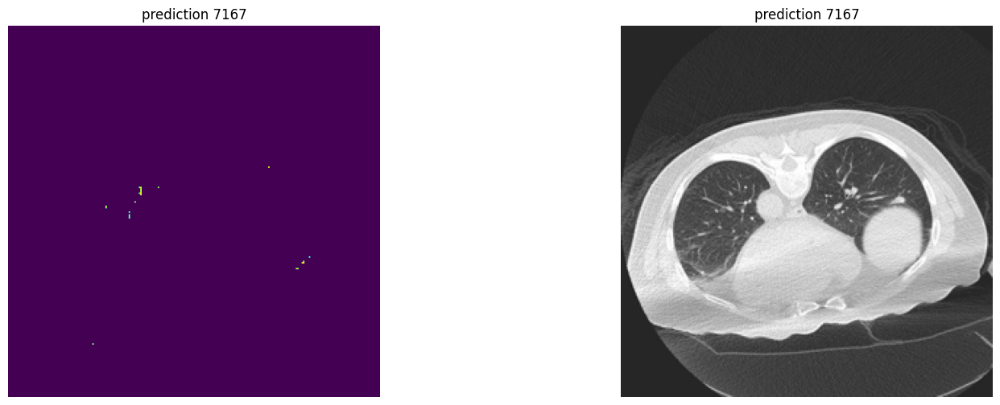

 53%|██████████████████████▏                   | 67/127 [07:57<06:58,  6.98s/it]

255
IMAGE IS BINARY


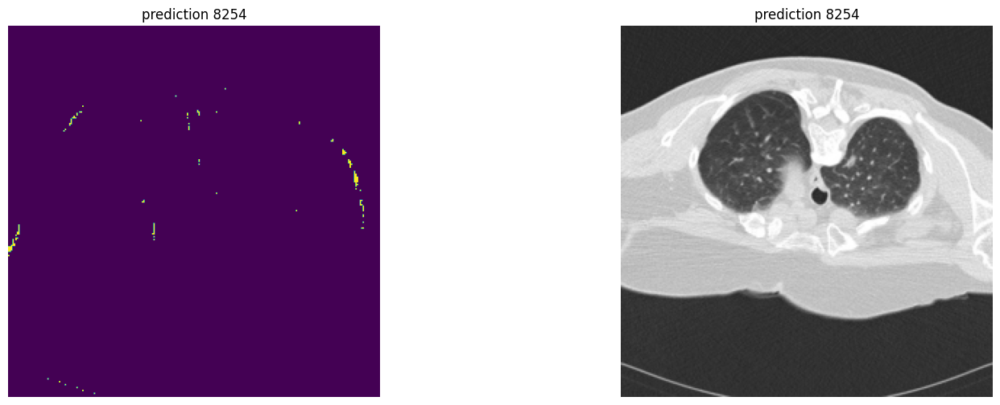

 54%|██████████████████████▍                   | 68/127 [08:04<06:51,  6.98s/it]

255
IMAGE IS BINARY


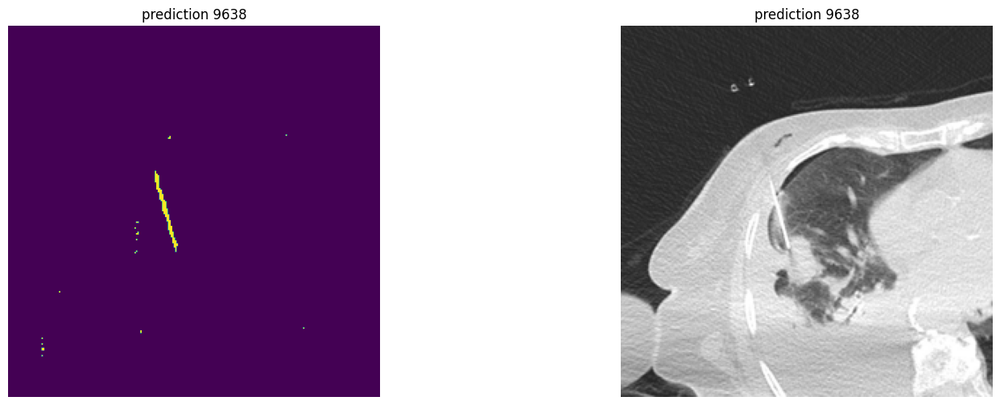

 54%|██████████████████████▊                   | 69/127 [08:12<06:46,  7.01s/it]

255
IMAGE IS BINARY


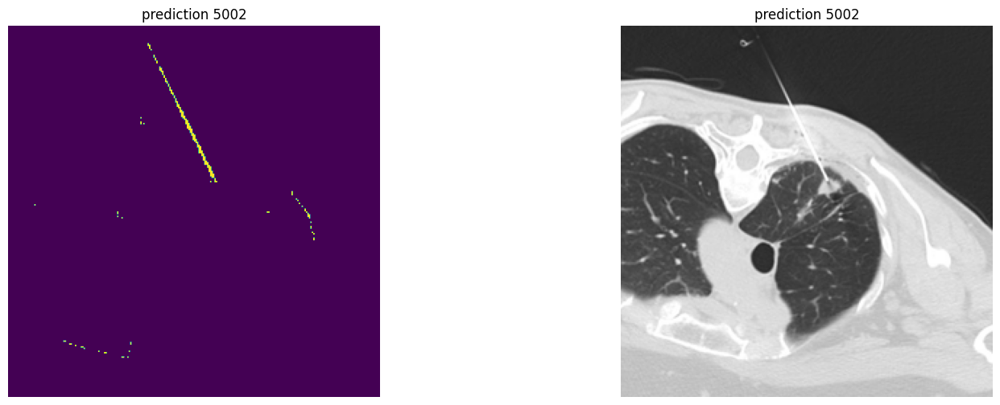

 55%|███████████████████████▏                  | 70/127 [08:19<06:42,  7.06s/it]

255
IMAGE IS BINARY


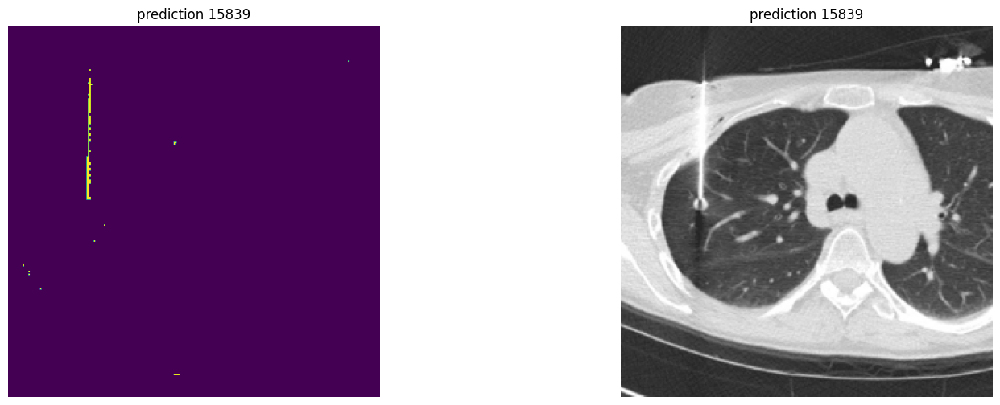

 56%|███████████████████████▍                  | 71/127 [08:26<06:37,  7.09s/it]

255
IMAGE IS BINARY


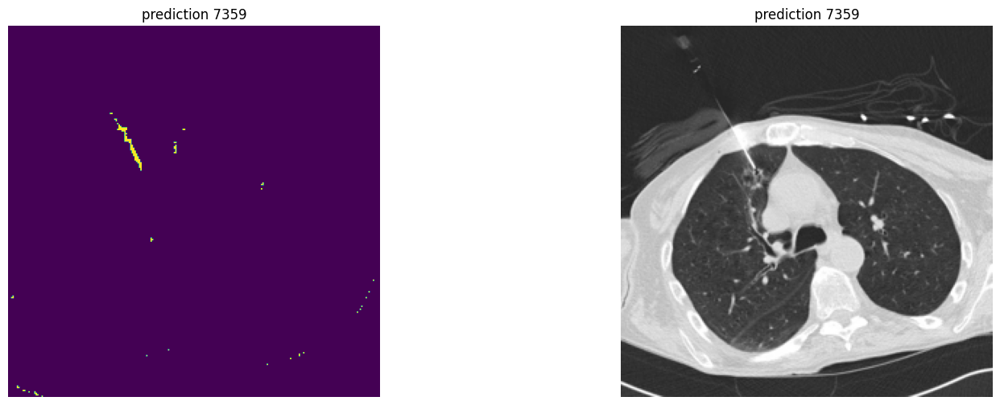

 57%|███████████████████████▊                  | 72/127 [08:33<06:35,  7.18s/it]

255
IMAGE IS BINARY


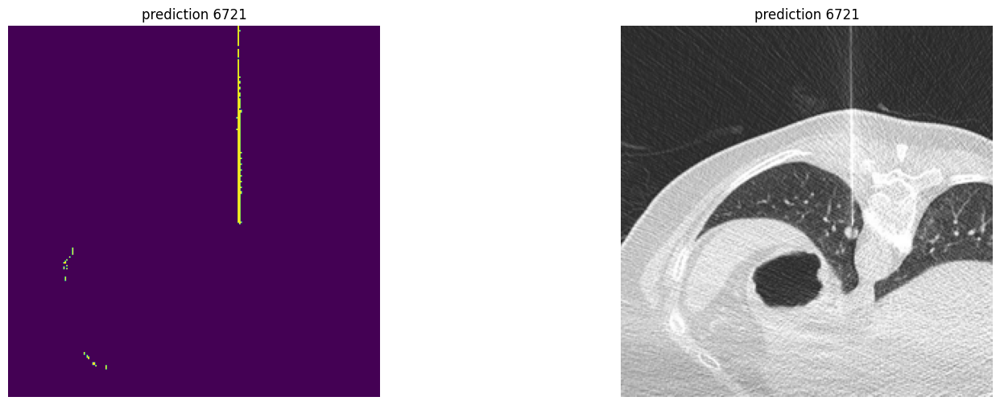

 57%|████████████████████████▏                 | 73/127 [08:41<06:31,  7.24s/it]

255
IMAGE IS BINARY


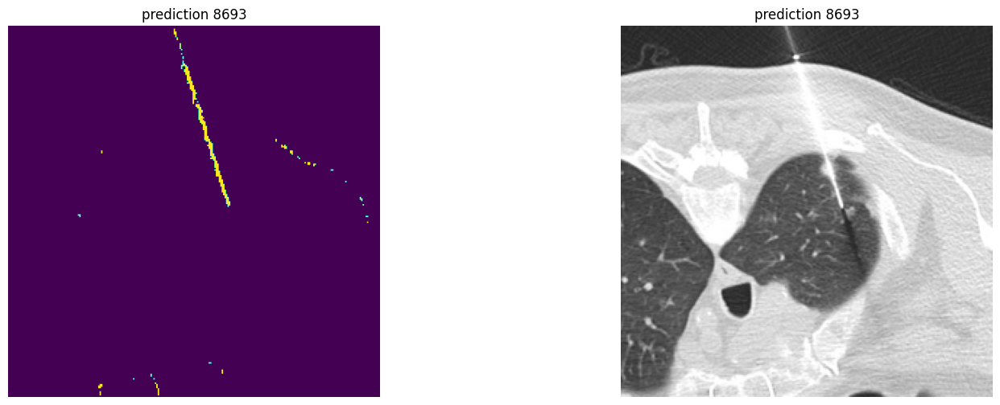

 58%|████████████████████████▍                 | 74/127 [08:48<06:25,  7.28s/it]

255
IMAGE IS BINARY


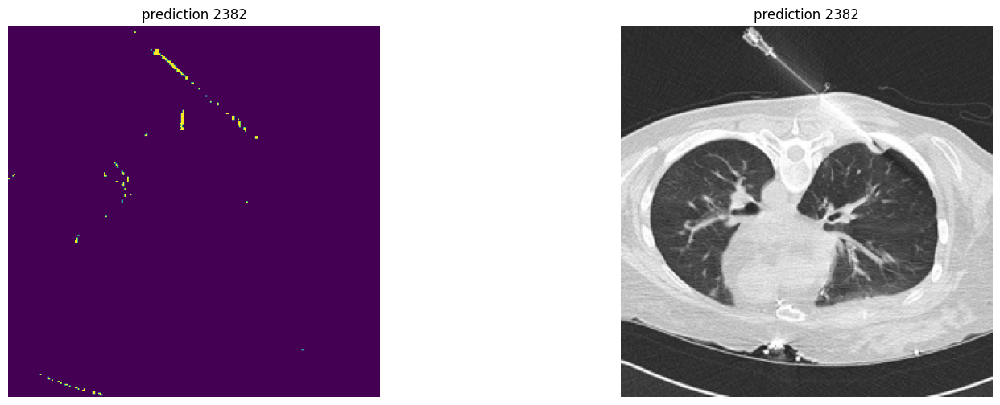

 59%|████████████████████████▊                 | 75/127 [08:55<06:19,  7.29s/it]

255
IMAGE IS BINARY


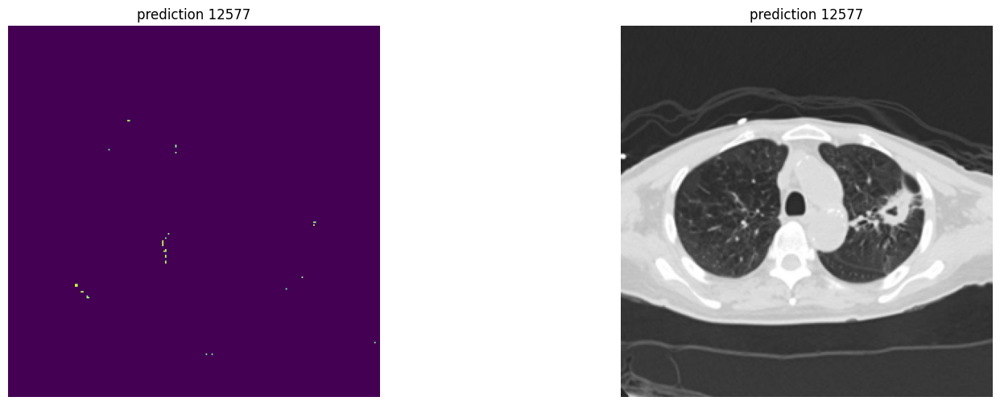

 60%|█████████████████████████▏                | 76/127 [09:03<06:13,  7.33s/it]

255
IMAGE IS BINARY


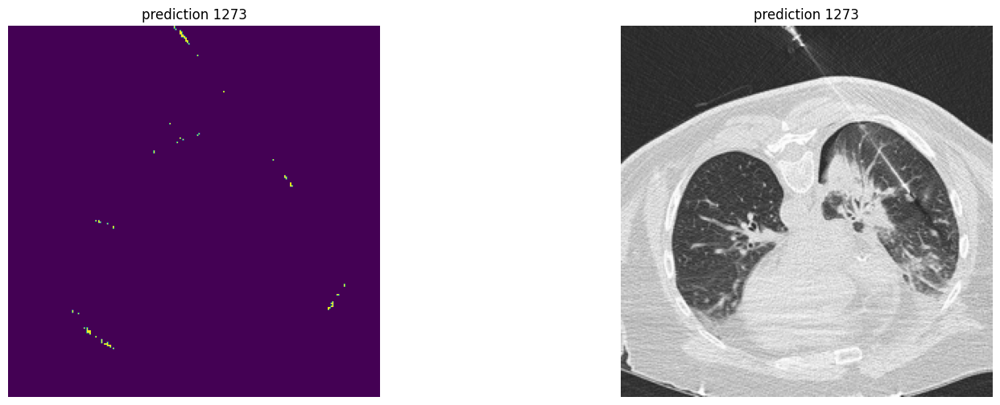

 61%|█████████████████████████▍                | 77/127 [09:10<06:10,  7.42s/it]

255
IMAGE IS BINARY


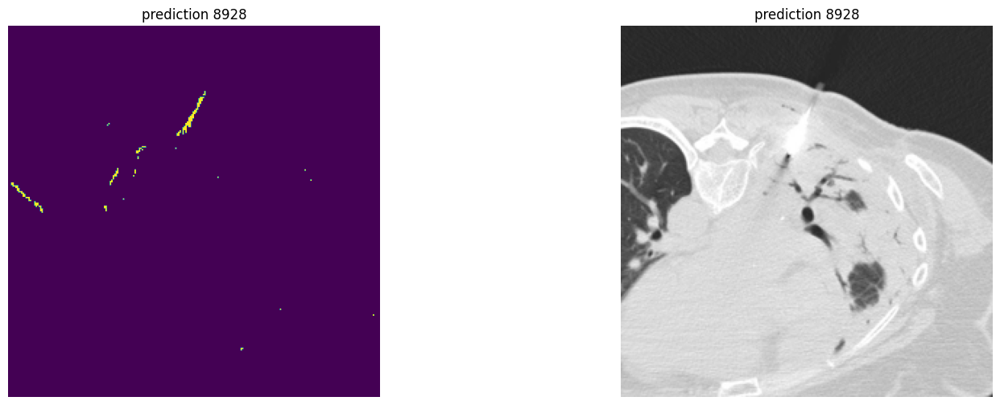

 61%|█████████████████████████▊                | 78/127 [09:18<06:04,  7.43s/it]

255
IMAGE IS BINARY


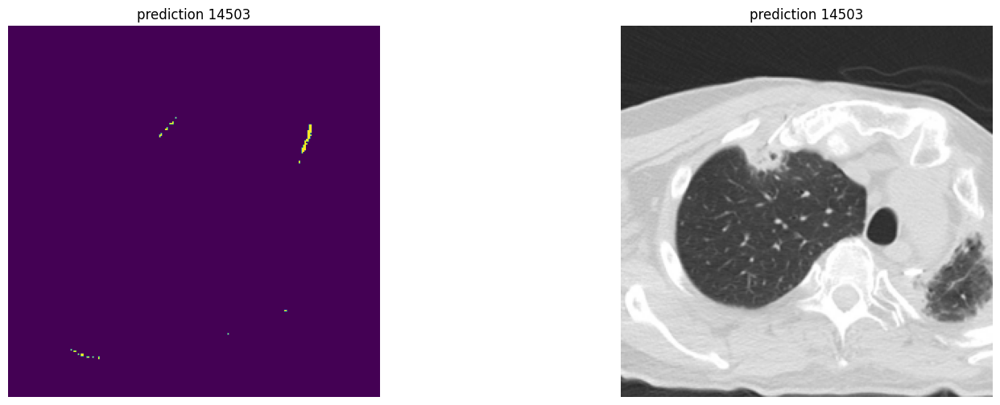

 62%|██████████████████████████▏               | 79/127 [09:25<05:58,  7.46s/it]

255
IMAGE IS BINARY


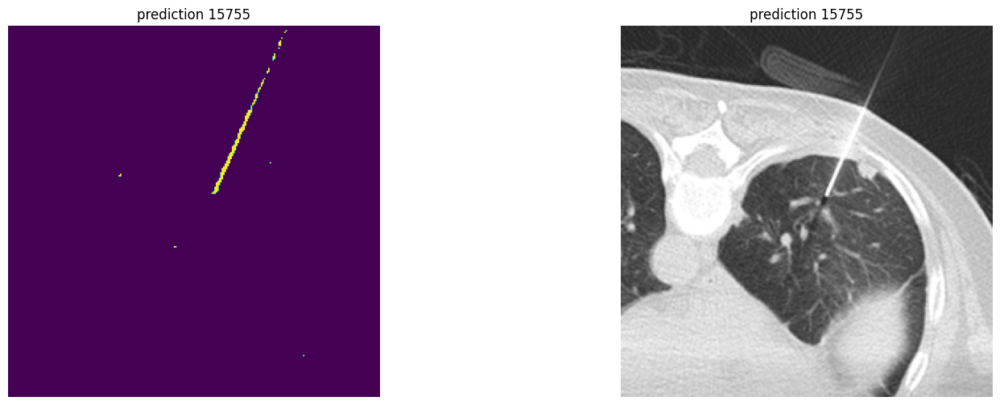

 63%|██████████████████████████▍               | 80/127 [09:33<05:51,  7.47s/it]

255
IMAGE IS BINARY


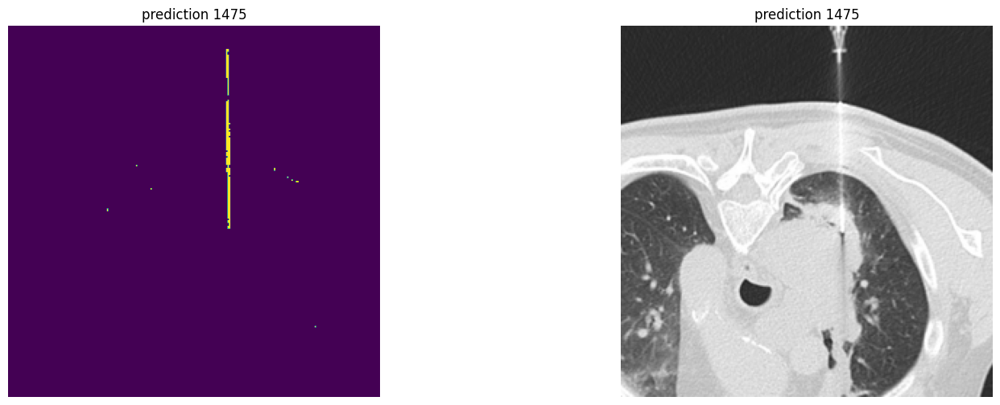

 64%|██████████████████████████▊               | 81/127 [09:40<05:38,  7.36s/it]

255
IMAGE IS BINARY


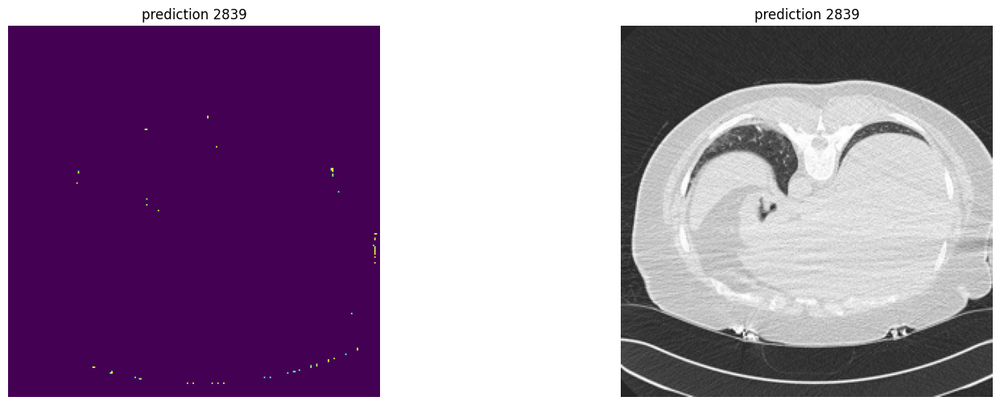

 65%|███████████████████████████               | 82/127 [09:47<05:31,  7.37s/it]

255
IMAGE IS BINARY


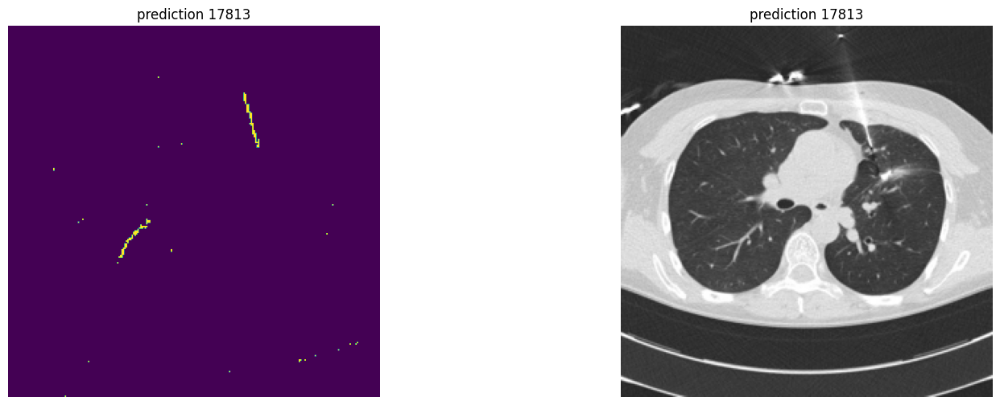

 65%|███████████████████████████▍              | 83/127 [09:55<05:26,  7.42s/it]

255
IMAGE IS BINARY


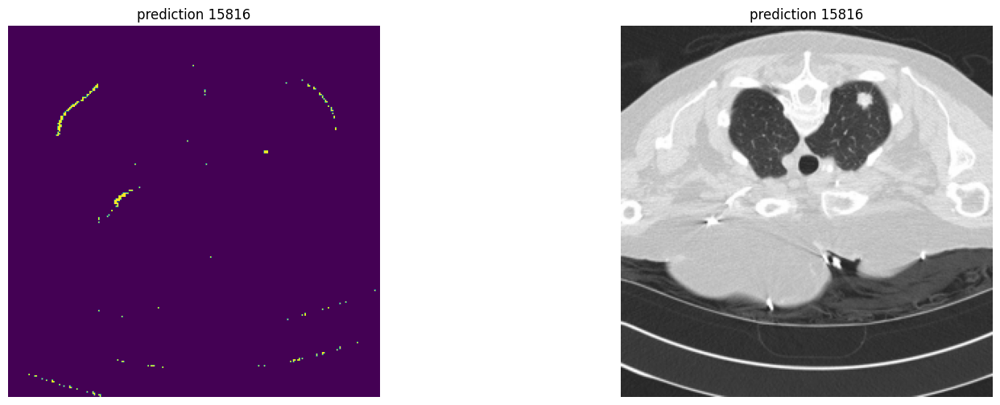

 66%|███████████████████████████▊              | 84/127 [10:02<05:20,  7.46s/it]

255
IMAGE IS BINARY


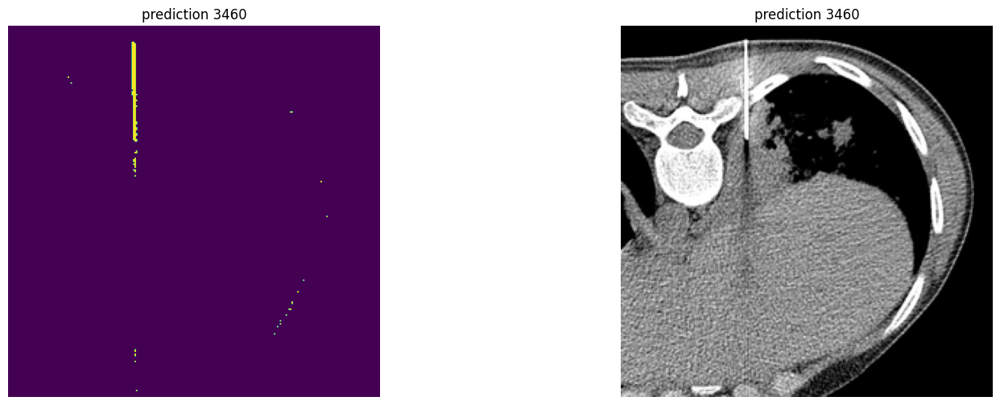

 67%|████████████████████████████              | 85/127 [10:10<05:14,  7.49s/it]

255
IMAGE IS BINARY


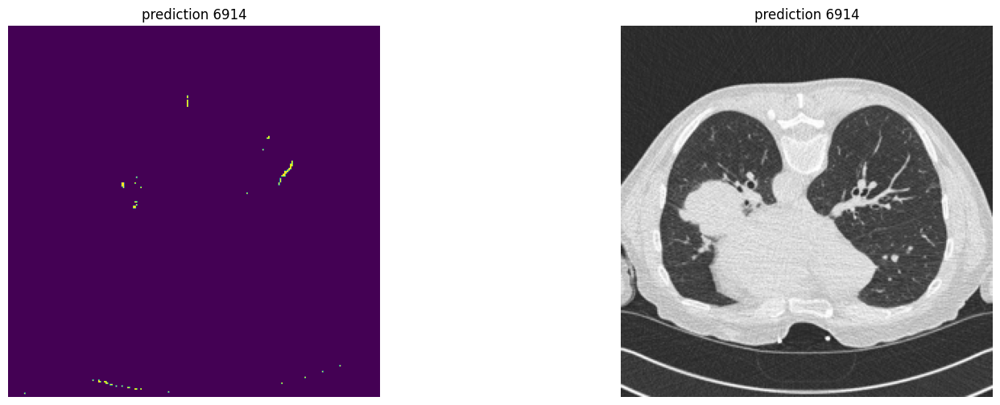

 68%|████████████████████████████▍             | 86/127 [10:17<05:02,  7.37s/it]

255
IMAGE IS BINARY


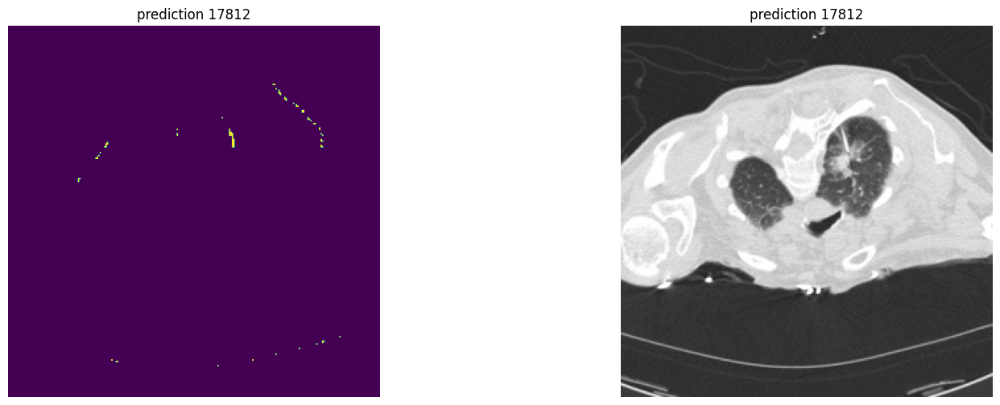

 69%|████████████████████████████▊             | 87/127 [10:24<04:51,  7.30s/it]

255
IMAGE IS BINARY


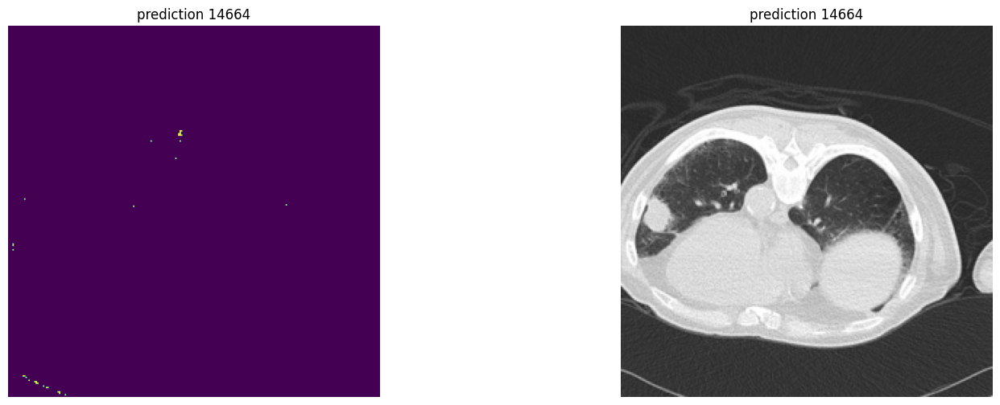

 69%|█████████████████████████████             | 88/127 [10:31<04:40,  7.19s/it]

255
IMAGE IS BINARY


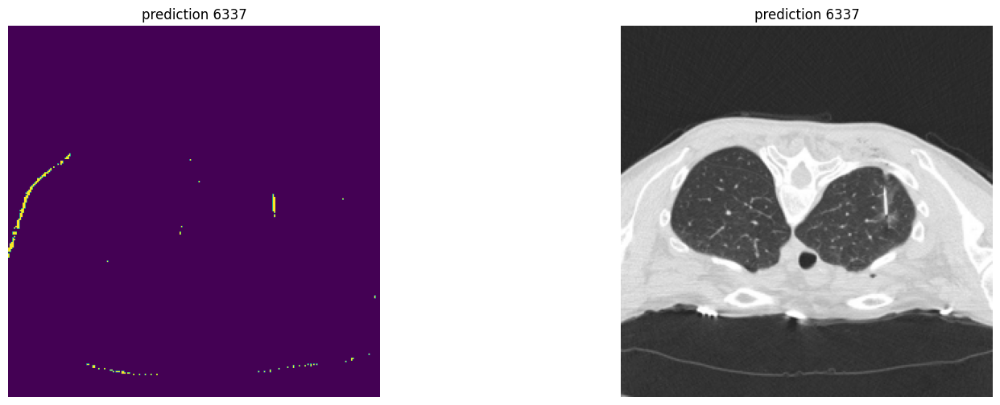

 70%|█████████████████████████████▍            | 89/127 [10:38<04:32,  7.16s/it]

255
IMAGE IS BINARY


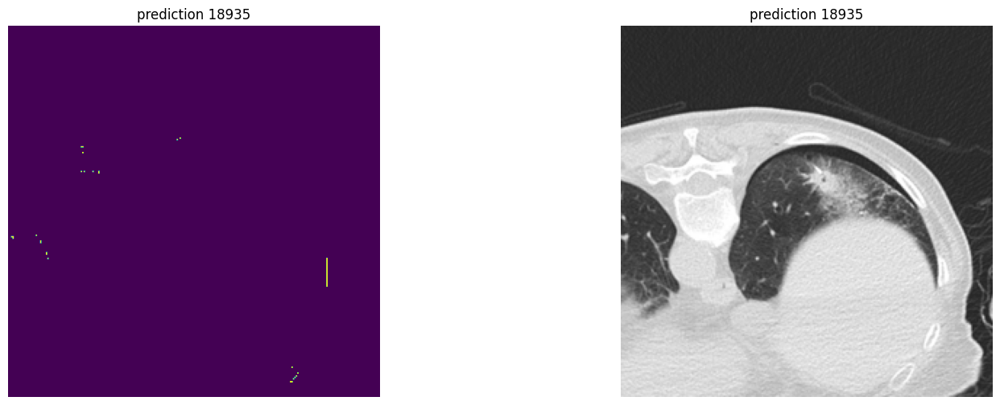

 71%|█████████████████████████████▊            | 90/127 [10:45<04:25,  7.17s/it]

255
IMAGE IS BINARY


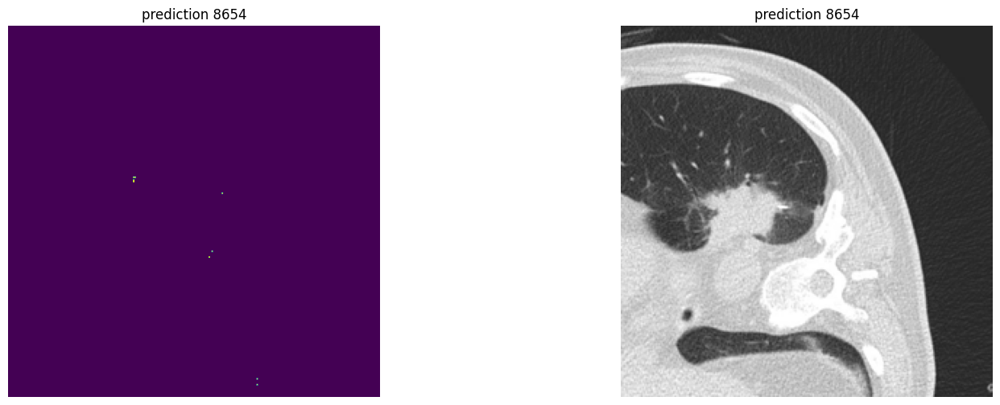

 72%|██████████████████████████████            | 91/127 [10:52<04:15,  7.09s/it]

255
IMAGE IS BINARY


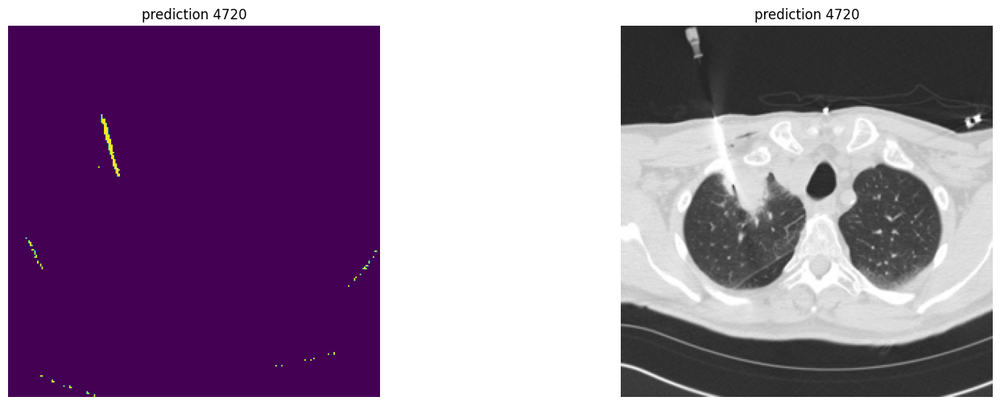

 72%|██████████████████████████████▍           | 92/127 [10:59<04:06,  7.03s/it]

255
IMAGE IS BINARY


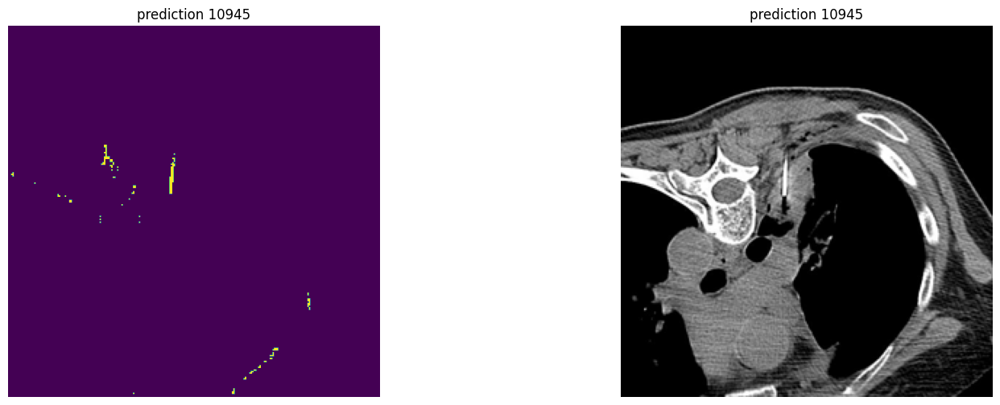

 73%|██████████████████████████████▊           | 93/127 [11:06<03:58,  7.01s/it]

255
IMAGE IS BINARY


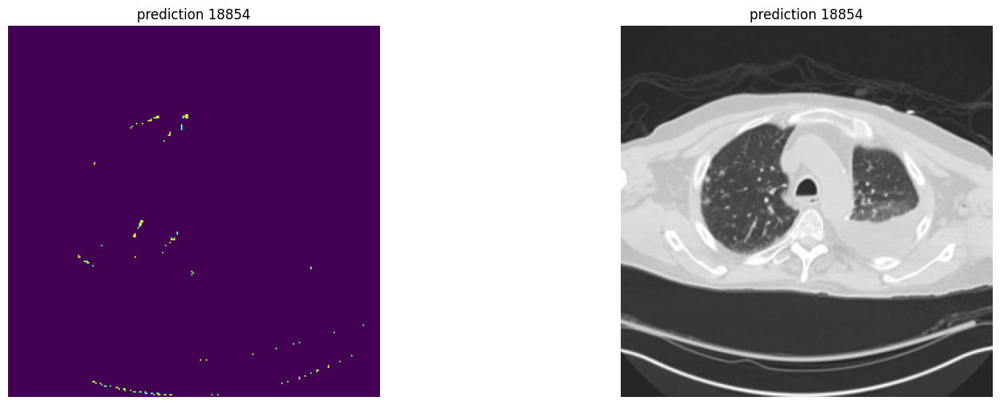

 74%|███████████████████████████████           | 94/127 [11:13<03:49,  6.97s/it]

255
IMAGE IS BINARY


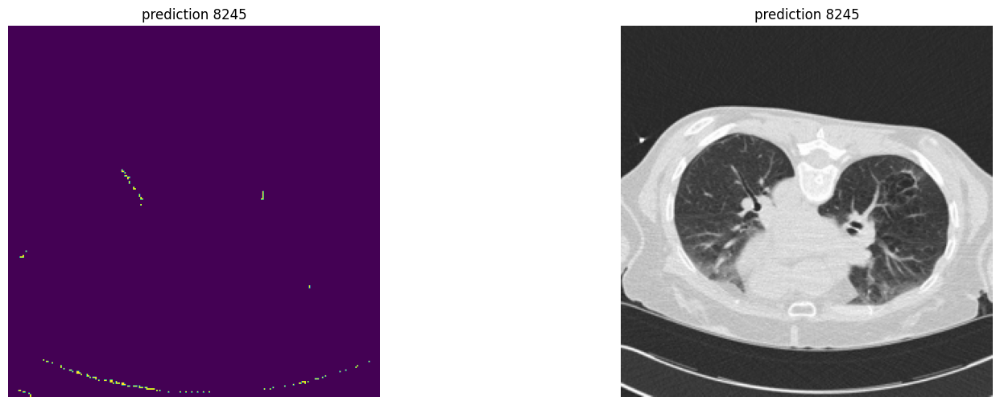

 75%|███████████████████████████████▍          | 95/127 [11:20<03:42,  6.94s/it]

255
IMAGE IS BINARY


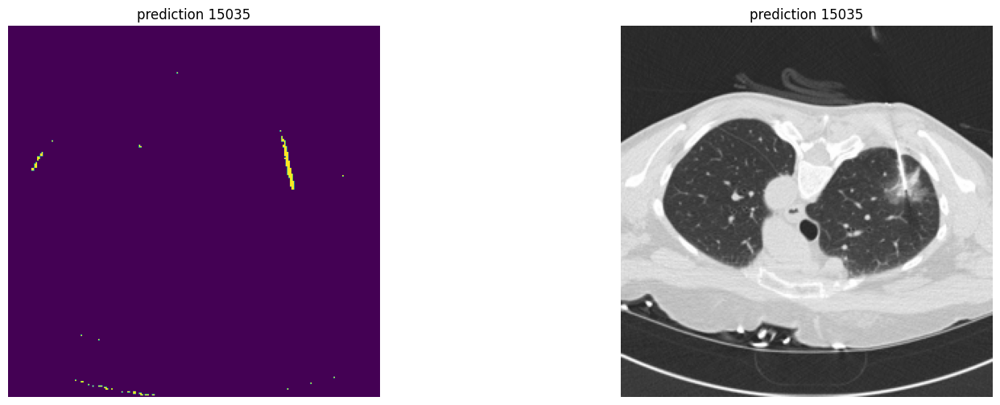

 76%|███████████████████████████████▋          | 96/127 [11:27<03:35,  6.94s/it]

255
IMAGE IS BINARY


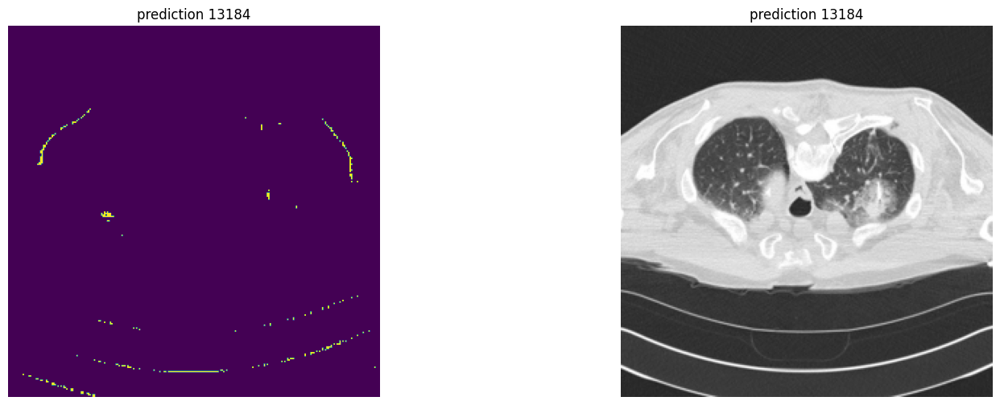

 76%|████████████████████████████████          | 97/127 [11:34<03:28,  6.94s/it]

255
IMAGE IS BINARY


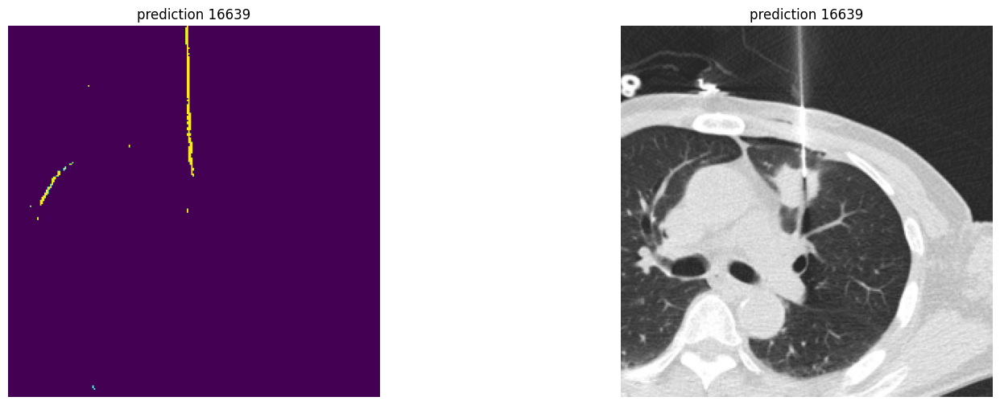

 77%|████████████████████████████████▍         | 98/127 [11:41<03:21,  6.97s/it]

255
IMAGE IS BINARY


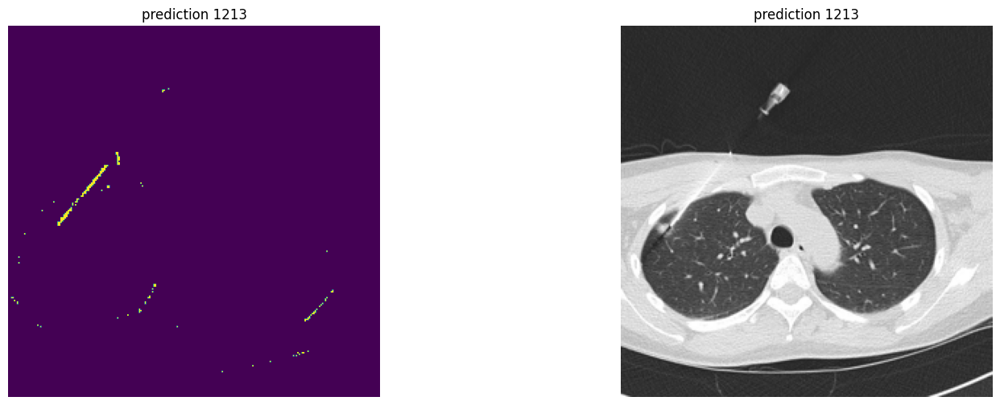

 78%|████████████████████████████████▋         | 99/127 [11:48<03:15,  6.97s/it]

255
IMAGE IS BINARY


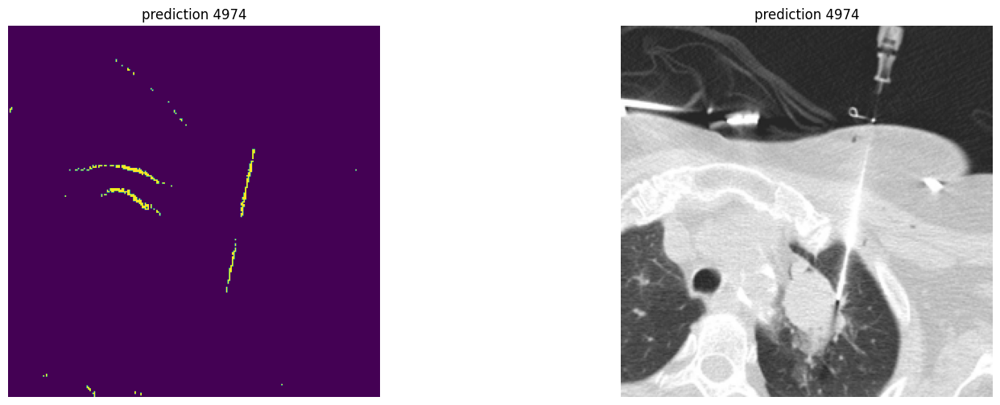

 79%|████████████████████████████████▎        | 100/127 [11:55<03:08,  6.98s/it]

255
IMAGE IS BINARY


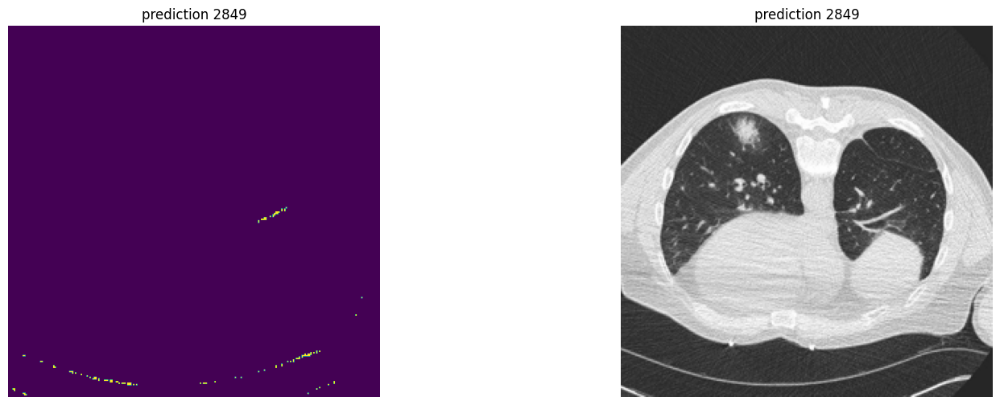

 80%|████████████████████████████████▌        | 101/127 [12:02<03:01,  6.99s/it]

255
IMAGE IS BINARY


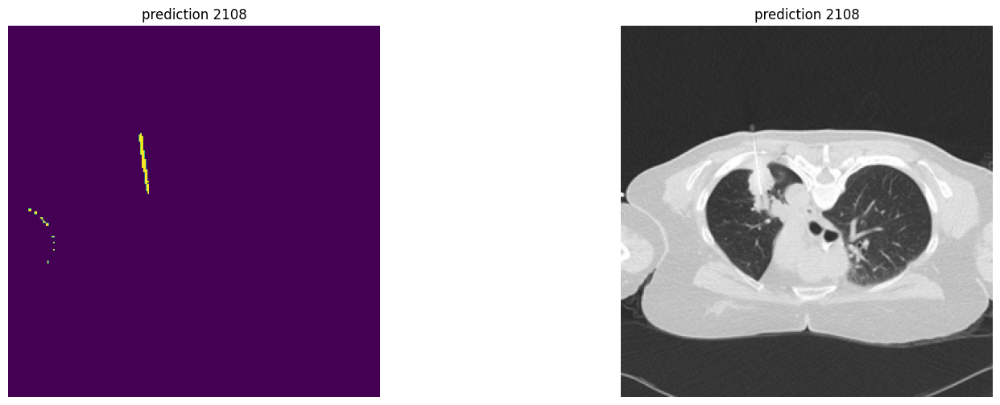

 80%|████████████████████████████████▉        | 102/127 [12:09<02:53,  6.95s/it]

255
IMAGE IS BINARY


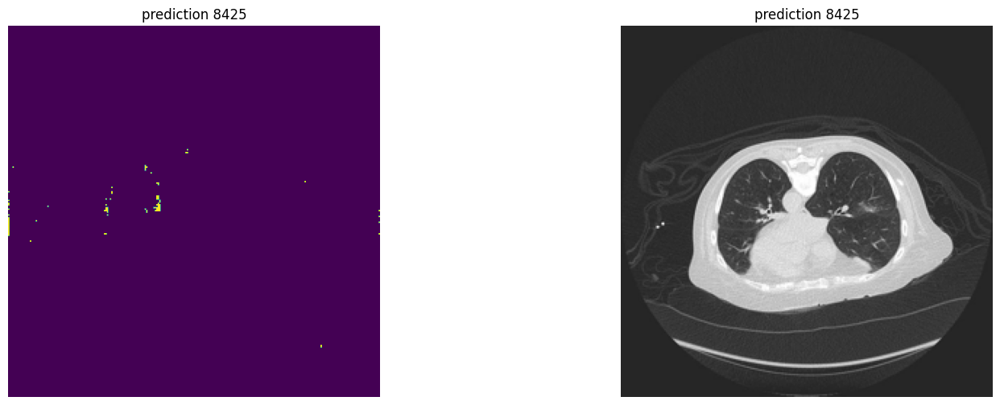

 81%|█████████████████████████████████▎       | 103/127 [12:16<02:47,  6.97s/it]

255
IMAGE IS BINARY


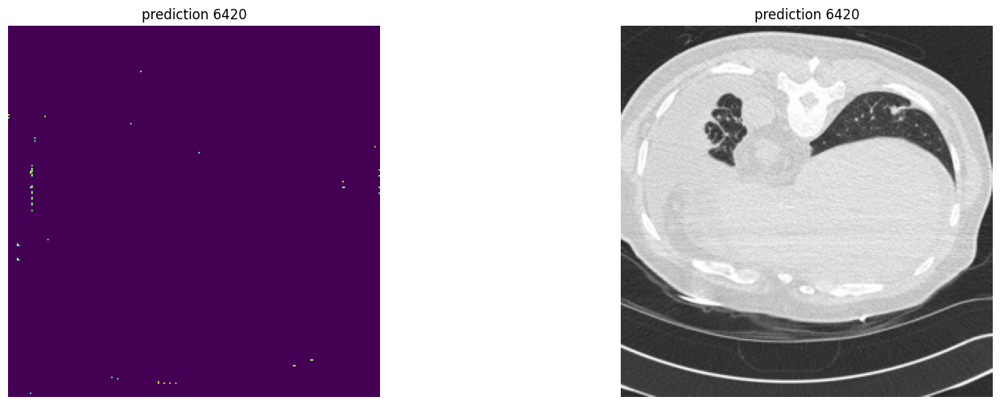

 82%|█████████████████████████████████▌       | 104/127 [12:23<02:40,  6.96s/it]

255
IMAGE IS BINARY


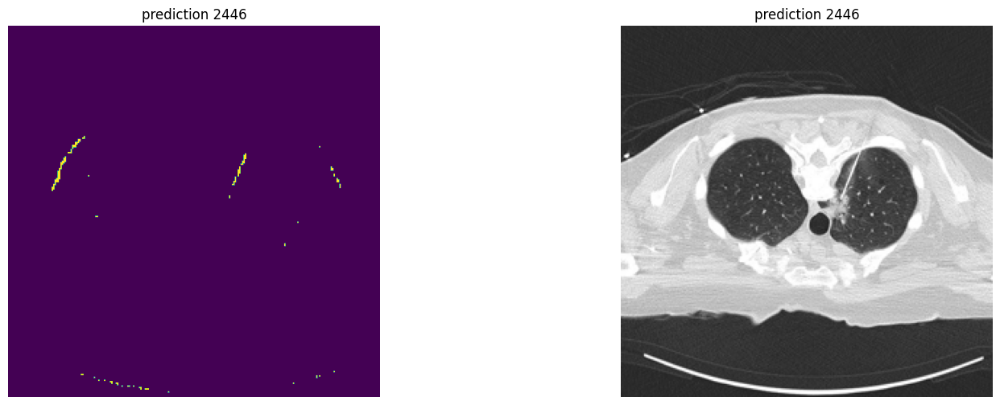

 83%|█████████████████████████████████▉       | 105/127 [12:30<02:37,  7.16s/it]

255
IMAGE IS BINARY


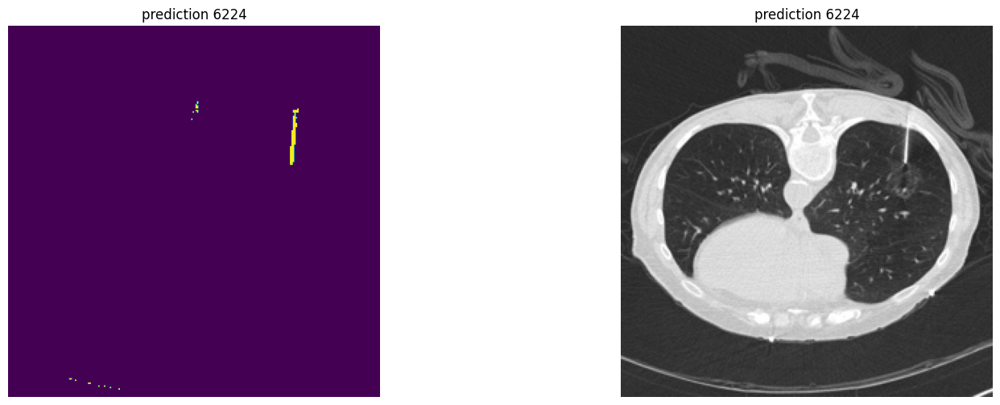

 83%|██████████████████████████████████▏      | 106/127 [12:37<02:30,  7.16s/it]

255
IMAGE IS BINARY


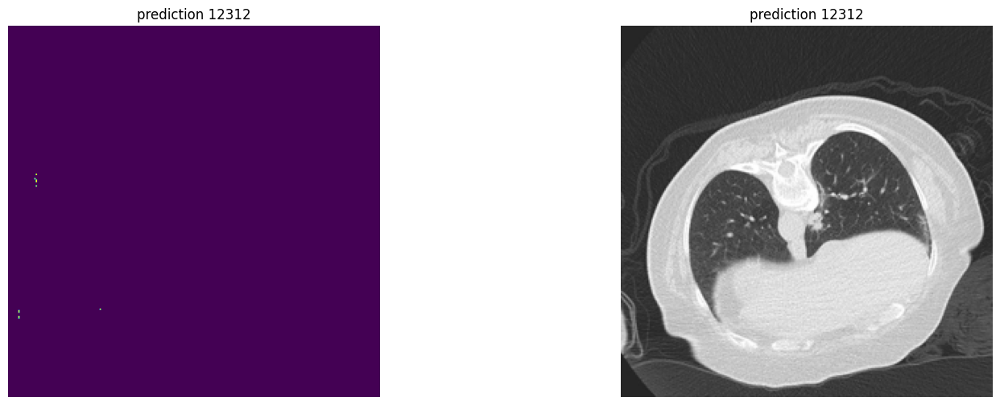

 84%|██████████████████████████████████▌      | 107/127 [12:44<02:22,  7.10s/it]

255
IMAGE IS BINARY


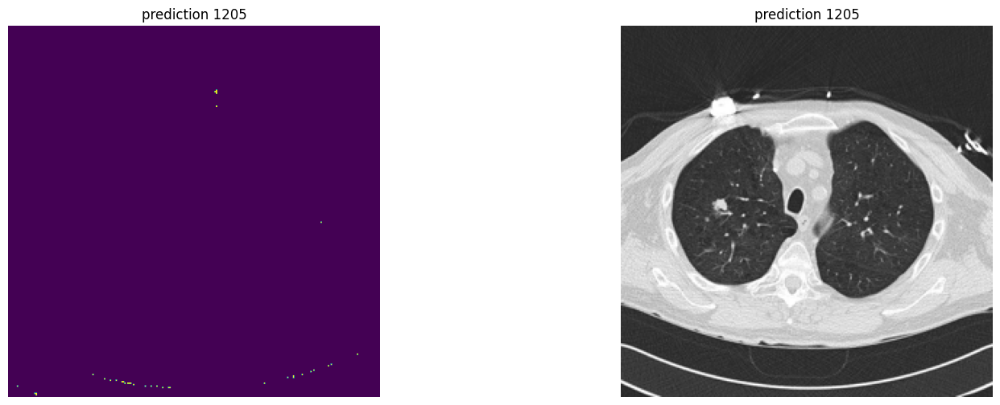

 85%|██████████████████████████████████▊      | 108/127 [12:51<02:13,  7.04s/it]

255
IMAGE IS BINARY


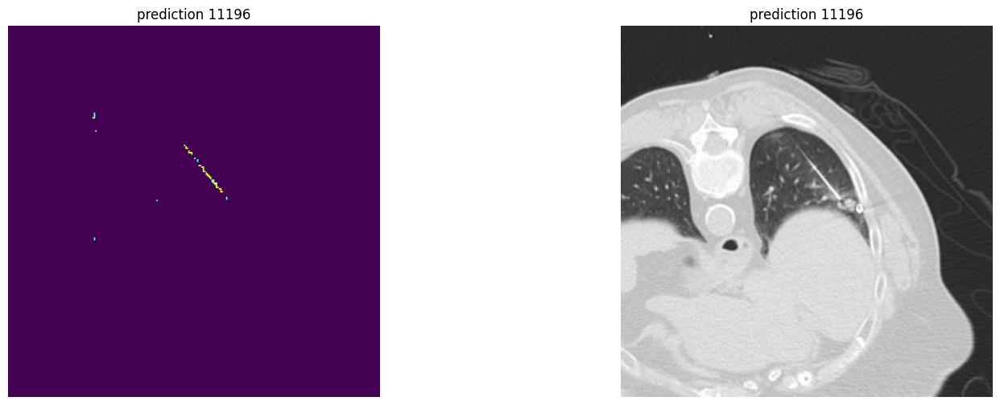

 86%|███████████████████████████████████▏     | 109/127 [12:58<02:06,  7.02s/it]

255
IMAGE IS BINARY


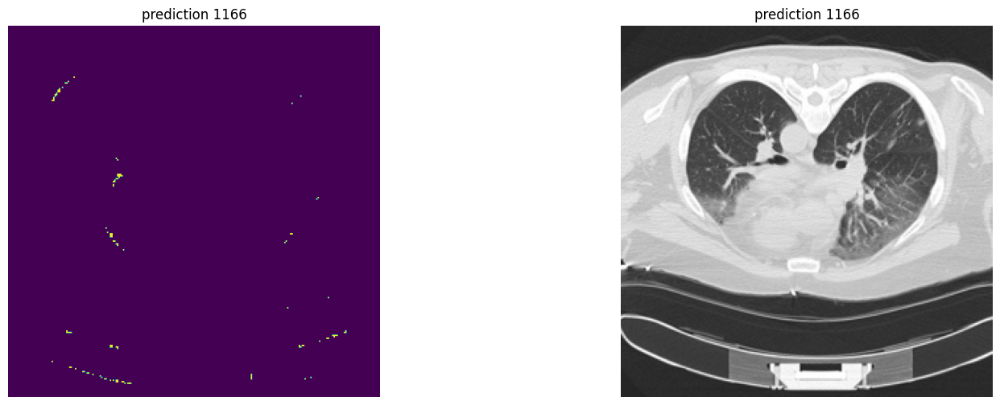

 87%|███████████████████████████████████▌     | 110/127 [13:05<01:59,  7.05s/it]

255
IMAGE IS BINARY


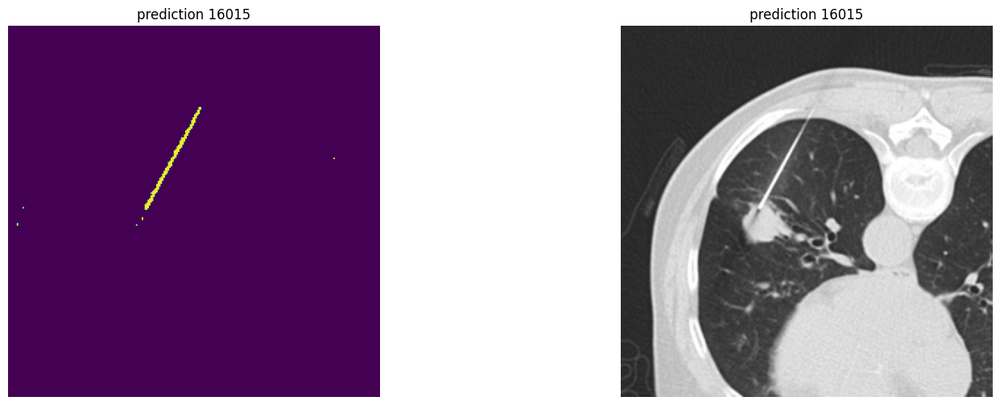

 87%|███████████████████████████████████▊     | 111/127 [13:12<01:52,  7.03s/it]

255
IMAGE IS BINARY


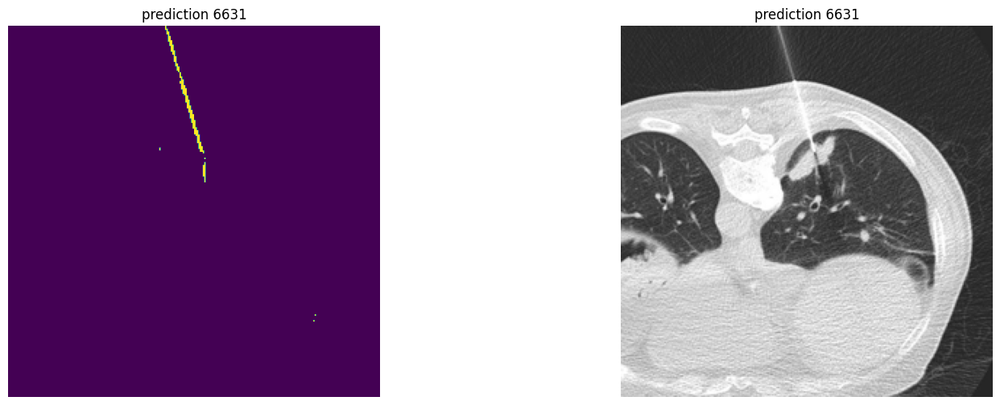

 88%|████████████████████████████████████▏    | 112/127 [13:19<01:45,  7.03s/it]

255
IMAGE IS BINARY


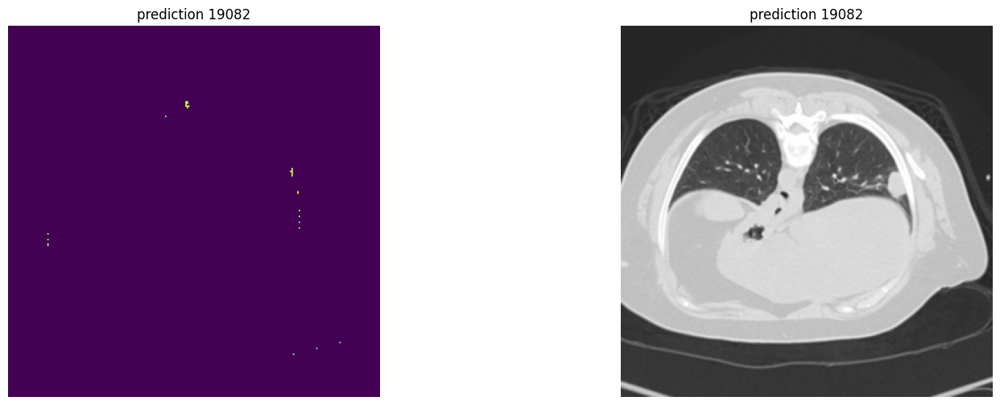

 89%|████████████████████████████████████▍    | 113/127 [13:27<01:38,  7.07s/it]

255
IMAGE IS BINARY


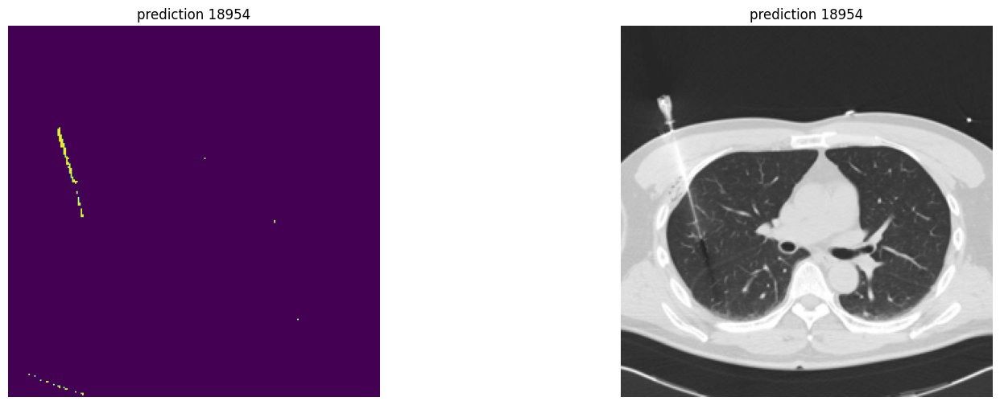

 90%|████████████████████████████████████▊    | 114/127 [13:33<01:31,  7.04s/it]

255
IMAGE IS BINARY


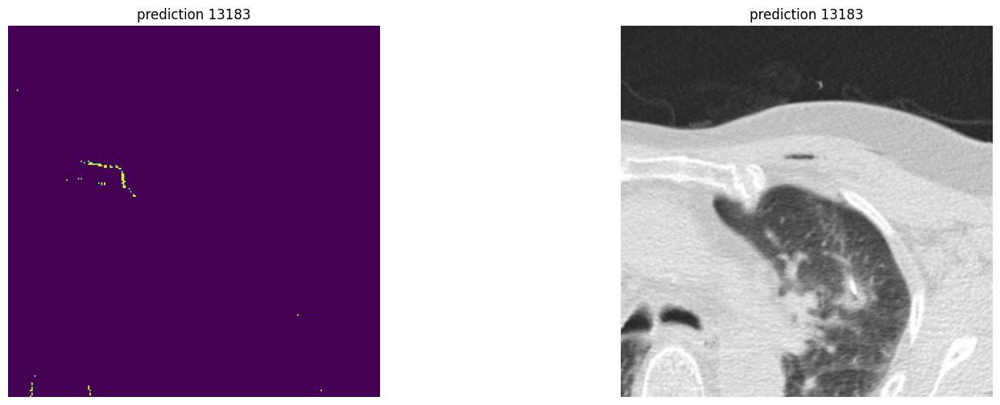

 91%|█████████████████████████████████████▏   | 115/127 [13:40<01:24,  7.00s/it]

255
IMAGE IS BINARY


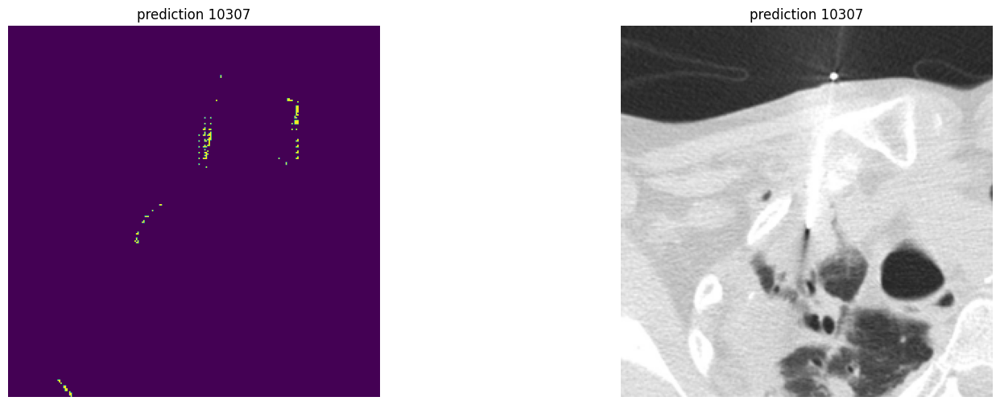

 91%|█████████████████████████████████████▍   | 116/127 [13:47<01:16,  7.00s/it]

255
IMAGE IS BINARY


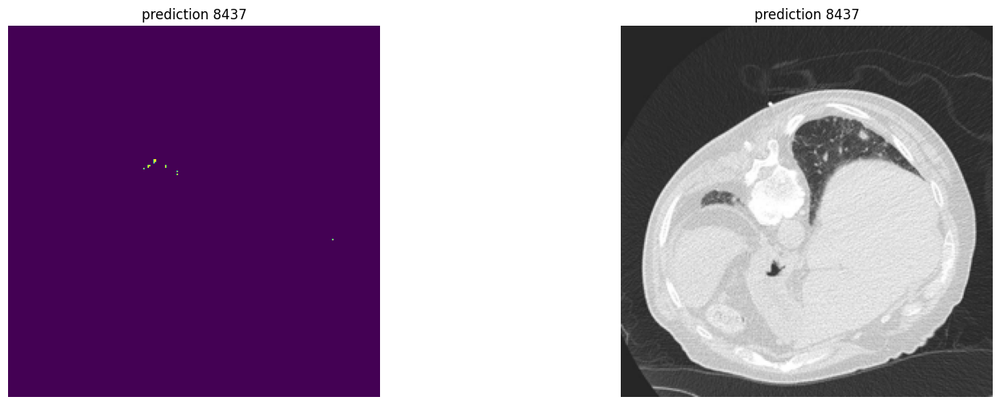

 92%|█████████████████████████████████████▊   | 117/127 [13:55<01:10,  7.09s/it]

255
IMAGE IS BINARY


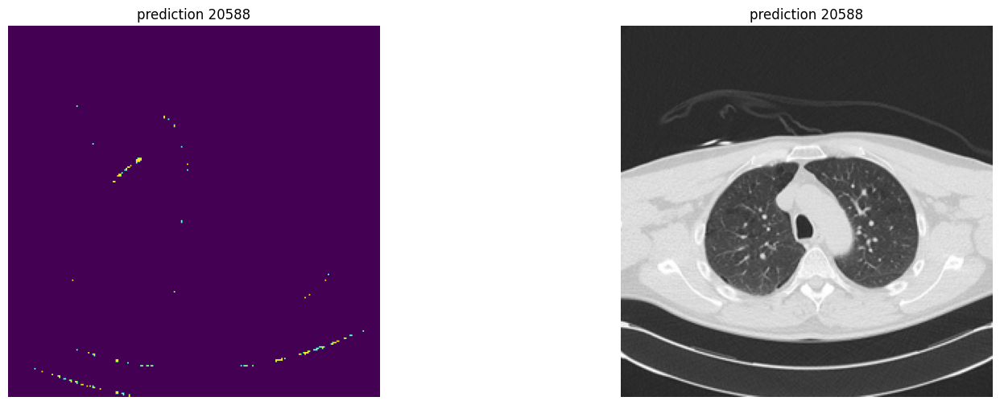

 93%|██████████████████████████████████████   | 118/127 [14:02<01:04,  7.15s/it]

255
IMAGE IS BINARY


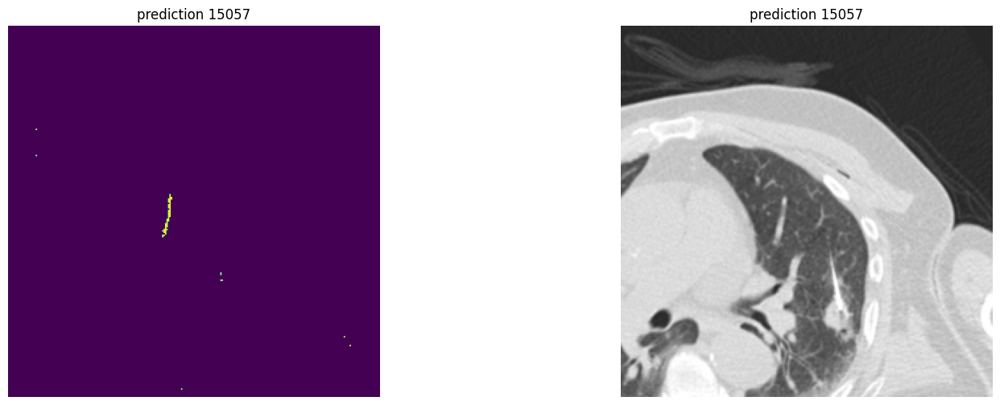

 94%|██████████████████████████████████████▍  | 119/127 [14:09<00:57,  7.17s/it]

255
IMAGE IS BINARY


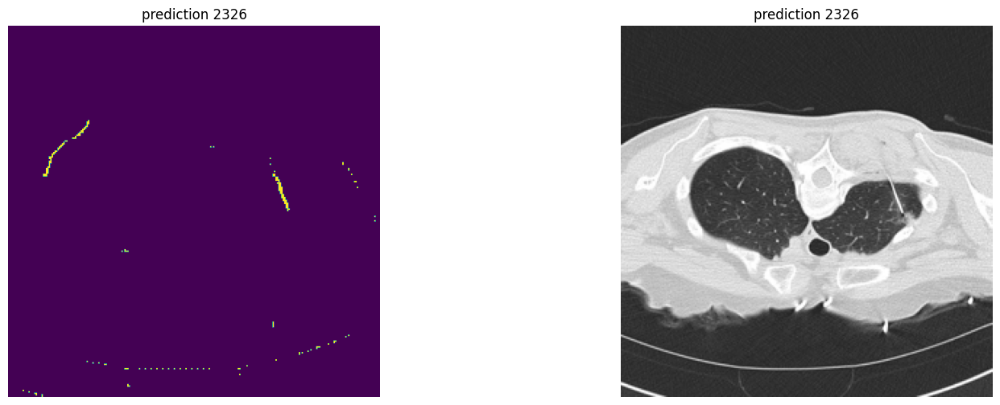

 94%|██████████████████████████████████████▋  | 120/127 [14:16<00:49,  7.11s/it]

255
IMAGE IS BINARY


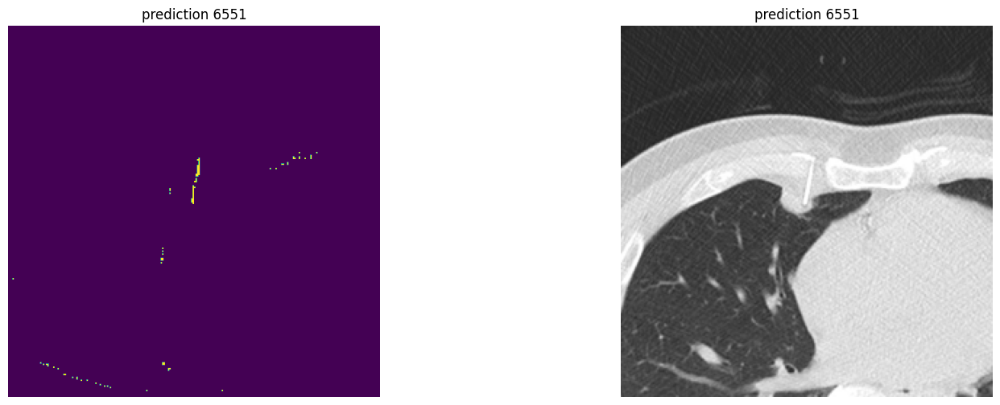

 95%|███████████████████████████████████████  | 121/127 [14:23<00:42,  7.05s/it]

255
IMAGE IS BINARY


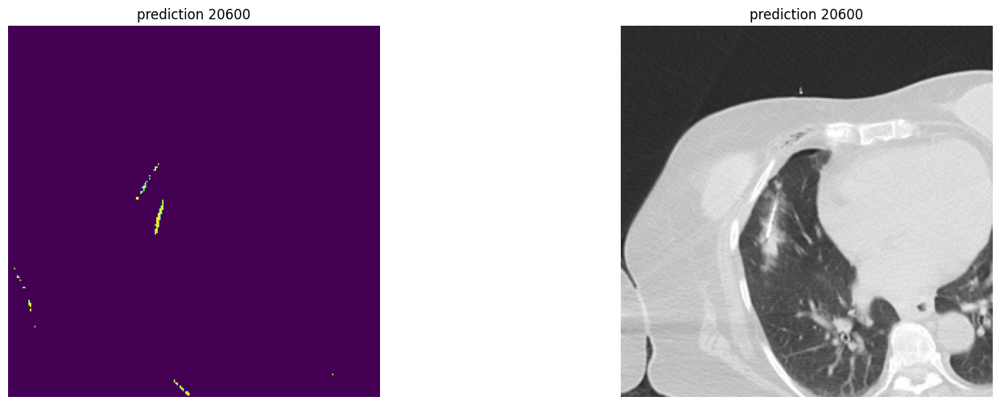

 96%|███████████████████████████████████████▍ | 122/127 [14:30<00:35,  7.08s/it]

255
IMAGE IS BINARY


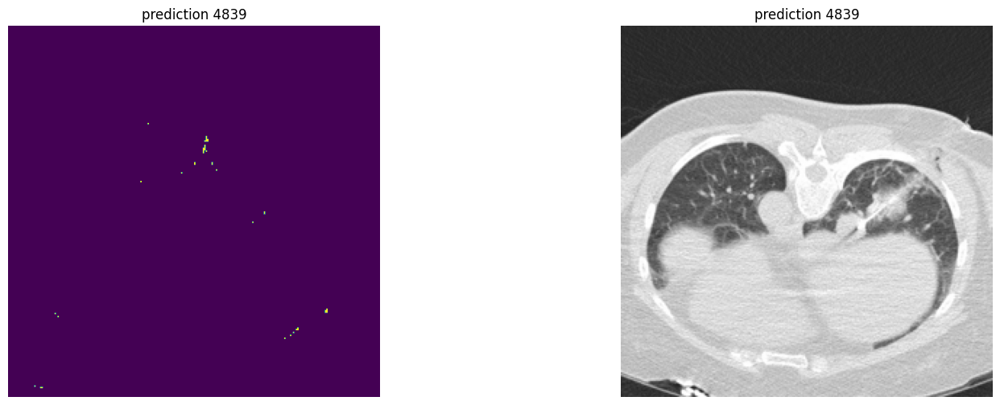

 97%|███████████████████████████████████████▋ | 123/127 [14:37<00:28,  7.10s/it]

255
IMAGE IS BINARY


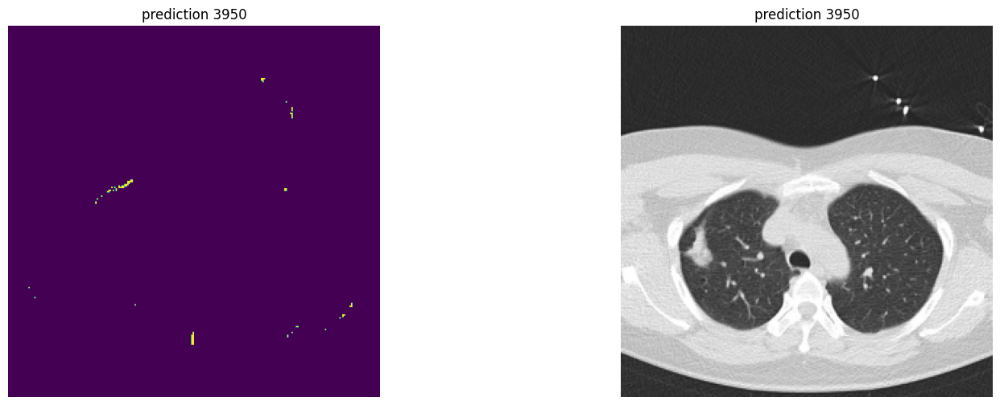

 98%|████████████████████████████████████████ | 124/127 [14:44<00:21,  7.08s/it]

255
IMAGE IS BINARY


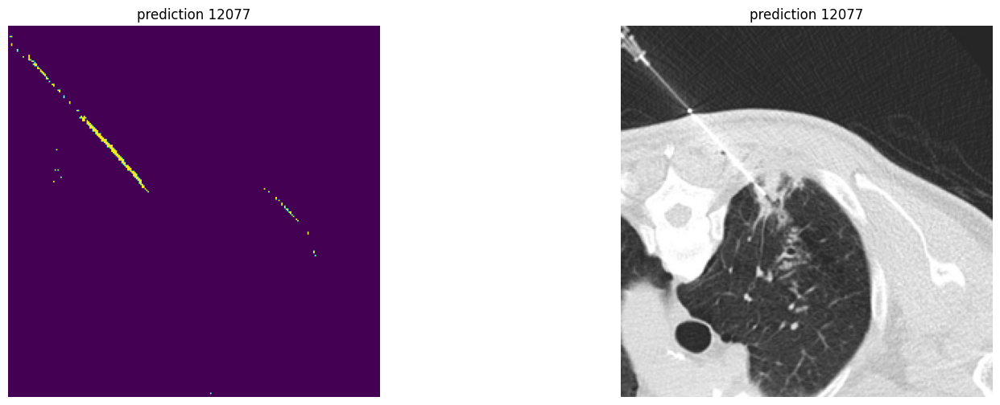

 98%|████████████████████████████████████████▎| 125/127 [14:52<00:14,  7.08s/it]

255
IMAGE IS BINARY


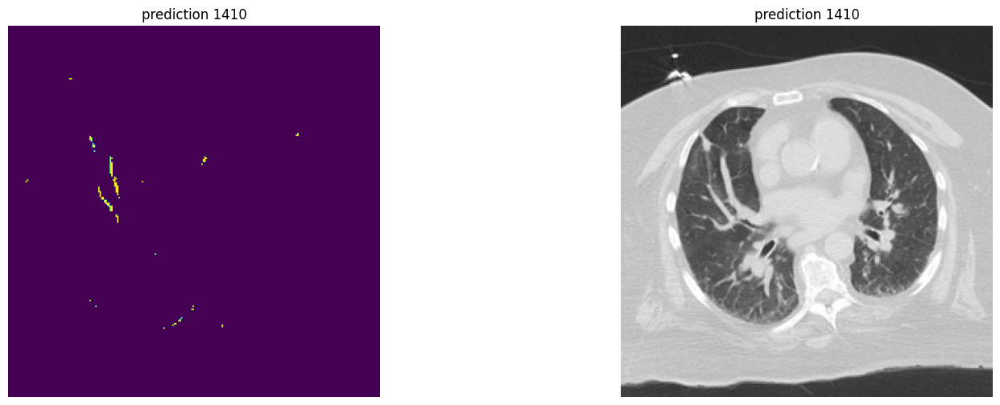

 99%|████████████████████████████████████████▋| 126/127 [14:58<00:07,  7.04s/it]

255
IMAGE IS BINARY


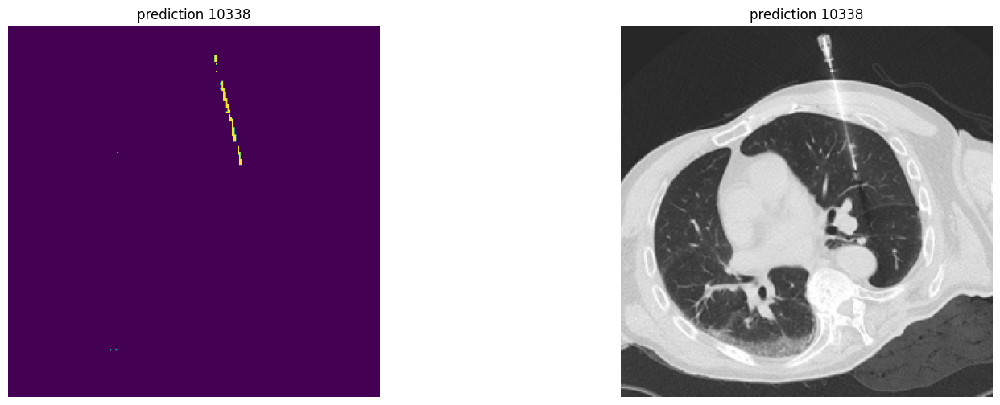

100%|█████████████████████████████████████████| 127/127 [15:05<00:00,  7.13s/it]


In [ ]:
from tqdm import tqdm

for filename in tqdm(os.listdir(test_dir)):
    # Check if the file is an image (you may need to adjust this condition based on your file types)
    if filename.endswith(".jpg"):

        image_id = os.path.splitext(filename)[0]  # Get filename without extension
        image_id = ''.join(filter(str.isdigit, image_id))  # Extract only digits from the filename

        # Load the image

        image_path = os.path.join(test_dir, filename)
        image = Image.open(image_path)

        image = image.convert("RGB")
        m, s = np.mean(image, axis=(0, 1)), np.std(image, axis=(0, 1))
        image = image.resize((256, 256))
        image_np = np.array(image)
        image_tensor = torch.from_numpy(image_np).float()
        # image_tensor = image_tensor.permute(1,2,0)

        # norm_image = transforms.Normalize(mean=m, std=s)
        #We will just use a single image instead of patchifying

        input_points = arbitrary_input_points()
        inputs = processor(image_tensor, input_points=input_points, return_tensors="pt")

        # Move the input tensor to the GPU if it's not already there
        inputs = {k: v.to(device) for k, v in inputs.items()}
        model.eval()


        # forward pass
        with torch.no_grad():
            outputs = model(**inputs, multimask_output=False)

        ######
        #From sanity check
        ######

        # apply sigmoid
        single_patch_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
        # convert soft mask to hard mask
        single_patch_prob = single_patch_prob.cpu().numpy().squeeze()


        single_patch_prediction = (single_patch_prob > 0.5).astype(np.uint8)

        binary_image = single_patch_prediction*255

        threshold = 128 #make sure image only has 0's and 255's



        mask_image = Image.fromarray(binary_image)


        mask_image = mask_image.resize((512,512))
        mask_image = mask_image.convert('L')

        test_np = np.array(mask_image)

        test_np[test_np > threshold] = 255
        test_np[test_np <= threshold] = 0


        mask_image = Image.fromarray(test_np)



        print(np.max(test_np))

        if not np.all((test_np == 0) | (test_np == 255)):
            print('NOT BINARY')
        else:
            print('IMAGE IS BINARY')




        mask_path = f'/Users/AdrianHanson/Desktop/Imaging Informatics/output_masks/{image_id}_pred.png'
        mask_image.save((mask_path))

        ######
        ######

        fig, axes = plt.subplots(1, 2, figsize=(18, 6))
        axes[0].imshow(mask_image)
        axes[0].set_title(f'prediction {image_id}')
        axes[0].axis('off')  # Hide axes for a cleaner look

        axes[1].imshow(image)
        axes[1].set_title(f'prediction {image_id}')
        axes[1].axis('off')  # Hide axes for a cleaner look


        plt.show()

#         # apply sigmoid
#         mask = torch.sigmoid(outputs.pred_masks.squeeze(1))
#         # convert soft mask to hard mask
#         mask = mask.cpu().numpy().squeeze()
#         mask = (mask > 0.5).astype(np.uint8)
#         mask_image = Image.fromarray(mask)
#         mask_image = mask_image.resize((512,512))









In [ ]:
#load in predicted masks as image directory
pred_dir = '/Users/AdrianHanson/Desktop/Imaging Informatics/output_masks'
save_dir = '/Users/AdrianHanson/Desktop/Imaging Informatics/Project Solutions'

In [ ]:
folder_path = 'path/to/your/folder'
png_files = [file for file in os.listdir(pred_dir) if file.endswith('.png')]
print(f"Number of .png files: {len(png_files)}")

Number of .png files: 127


In [ ]:
import pandas as pd
def processImages(imgDirectory: str, saveDirectory: str = os.getcwd(), returnDF:bool = False) -> pd.DataFrame | None:
    """
    Process binarized predicted mask images saved in a directory, implement checks,
    and create a `'submission.csv'` submission file containing image status and mask indices.

    **Do NOT modify this function.**

    Parameters
    ----------
    imgDirectory : str
        The directory containing the images to be processed. It should have exactly 127 .png files.
        When you save your model's predicted masks, make sure the pixel values
        are either 0 or 255, and save it as a .png file (preferably using PIL).
    saveDirectory : str, optional
        The directory where the resulting DataFrame will be saved as a CSV file.
        Defaults to the current directory.
    returnDF : bool, optional
        Whether to return the DataFrame. Defaults to False.

    Returns
    -------
    df: A DataFrame with columns 'imageID', 'status', and 'mask', indexed by 'imageID' if `returnDF` is True, else None

    Raises
    ------
    ValueError
        If the number of .png files in `imgDirectory` is not 127,
        if any image is not binary, or if any image is not 512x512 pixels.

    Example Usage
    -------------
    `processImages('path/to/img/folder', 'path/to/save/folder')`
    """

    files = [f for f in os.listdir(imgDirectory) if f.endswith('.png')]  # Get all .png files in the directory
    if len(files) != 127:
        raise ValueError("Directory must contain exactly 127 .png files")

    files.sort(key=lambda x: int(x.split('_')[0]))  # Sort the files


    data = []  # List of dictionaries to be converted to DataFrame
    for file in files:
        imgPath = os.path.join(imgDirectory, file)
        img = np.array(Image.open(imgPath).convert('L'), dtype=np.uint8)

        # Check if image is binary
        if not np.array_equal(img, img.astype(bool).astype(img.dtype) * 255):
            raise ValueError(f"Image {file} is not binary")
        # Check image size
        if img.shape != (512, 512):
            raise ValueError(f"Image {file} is not of size 512x512")

        status = 1 if np.any(img == 255) else 0  # Determine status of image
        maskIndices = ' '.join(map(str, np.nonzero(img.flatten() == 255)[0])) if status else '-100'

        data.append({'imageID': int(file.split('_')[0]), 'status': status, 'mask': maskIndices})

    df = pd.DataFrame(data).set_index('imageID')
    df.to_csv(os.path.join(saveDirectory, 'submission.csv'))

    if returnDF: return df


In [ ]:
#get output CSV for submission
processImages(pred_dir, save_dir)